# Implementing a Neural Network
In this exercise we will develop a neural network with fully-connected layers to perform classification, and test it out on the CIFAR-10 dataset.

In [38]:
# A bit of setup

import numpy as np
import matplotlib.pyplot as plt

from cs231n.classifiers.neural_net import TwoLayerNet

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

def rel_error(x, y):
  """ returns relative error """
  return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


We will use the class `TwoLayerNet` in the file `cs231n/classifiers/neural_net.py` to represent instances of our network. The network parameters are stored in the instance variable `self.params` where keys are string parameter names and values are numpy arrays. Below, we initialize toy data and a toy model that we will use to develop your implementation.

In [39]:
# Create a small net and some toy data to check your implementations.
# Note that we set the random seed for repeatable experiments.

input_size = 4
hidden_size = 10
num_classes = 3
num_inputs = 5

def init_toy_model():
  np.random.seed(0)
  return TwoLayerNet(input_size, hidden_size, num_classes, std=1e-1)

def init_toy_data():
  np.random.seed(1)
  X = 10 * np.random.randn(num_inputs, input_size)
  y = np.array([0, 1, 2, 2, 1])
  return X, y

net = init_toy_model()
X, y = init_toy_data()

# Forward pass: compute scores
Open the file `cs231n/classifiers/neural_net.py` and look at the method `TwoLayerNet.loss`. This function is very similar to the loss functions you have written for the SVM and Softmax exercises: It takes the data and weights and computes the class scores, the loss, and the gradients on the parameters. 

Implement the first part of the forward pass which uses the weights and biases to compute the scores for all inputs.

In [40]:
scores = net.loss(X)
print 'Your scores:'
print scores
print
print 'correct scores:'
correct_scores = np.asarray([
  [-0.81233741, -1.27654624, -0.70335995],
  [-0.17129677, -1.18803311, -0.47310444],
  [-0.51590475, -1.01354314, -0.8504215 ],
  [-0.15419291, -0.48629638, -0.52901952],
  [-0.00618733, -0.12435261, -0.15226949]])
print correct_scores
print

# The difference should be very small. We get < 1e-7
print 'Difference between your scores and correct scores:'
print np.sum(np.abs(scores - correct_scores))

Your scores:
[[-0.81233741 -1.27654624 -0.70335995]
 [-0.17129677 -1.18803311 -0.47310444]
 [-0.51590475 -1.01354314 -0.8504215 ]
 [-0.15419291 -0.48629638 -0.52901952]
 [-0.00618733 -0.12435261 -0.15226949]]

correct scores:
[[-0.81233741 -1.27654624 -0.70335995]
 [-0.17129677 -1.18803311 -0.47310444]
 [-0.51590475 -1.01354314 -0.8504215 ]
 [-0.15419291 -0.48629638 -0.52901952]
 [-0.00618733 -0.12435261 -0.15226949]]

Difference between your scores and correct scores:
3.68027209255e-08


# Forward pass: compute loss
In the same function, implement the second part that computes the data and regularizaion loss.

In [41]:
loss, _ = net.loss(X, y, reg=0.1)
correct_loss = 1.30378789133

# should be very small, we get < 1e-12
print 'Difference between your loss and correct loss:'
print np.sum(np.abs(loss - correct_loss))

Difference between your loss and correct loss:
1.79412040779e-13


# Backward pass
Implement the rest of the function. This will compute the gradient of the loss with respect to the variables `W1`, `b1`, `W2`, and `b2`. Now that you (hopefully!) have a correctly implemented forward pass, you can debug your backward pass using a numeric gradient check:

In [42]:
from cs231n.gradient_check import eval_numerical_gradient

# Use numeric gradient checking to check your implementation of the backward pass.
# If your implementation is correct, the difference between the numeric and
# analytic gradients should be less than 1e-8 for each of W1, W2, b1, and b2.

loss, grads = net.loss(X, y, reg=0.1)

# these should all be less than 1e-8 or so
for param_name in grads:
  f = lambda W: net.loss(X, y, reg=0.1)[0]
  param_grad_num = eval_numerical_gradient(f, net.params[param_name], verbose=False)
  print '%s max relative error: %e' % (param_name, rel_error(param_grad_num, grads[param_name]))

b2 max relative error: 3.865070e-11
b1 max relative error: 2.738421e-09
W1 max relative error: 3.561318e-09
W2 max relative error: 3.440708e-09


# Train the network
To train the network we will use stochastic gradient descent (SGD), similar to the SVM and Softmax classifiers. Look at the function `TwoLayerNet.train` and fill in the missing sections to implement the training procedure. This should be very similar to the training procedure you used for the SVM and Softmax classifiers. You will also have to implement `TwoLayerNet.predict`, as the training process periodically performs prediction to keep track of accuracy over time while the network trains.

Once you have implemented the method, run the code below to train a two-layer network on toy data. You should achieve a training loss less than 0.2.

# Load the data
Now that you have implemented a two-layer network that passes gradient checks and works on toy data, it's time to load up our favorite CIFAR-10 data so we can use it to train a classifier on a real dataset.

Final training loss:  0.0156349876119


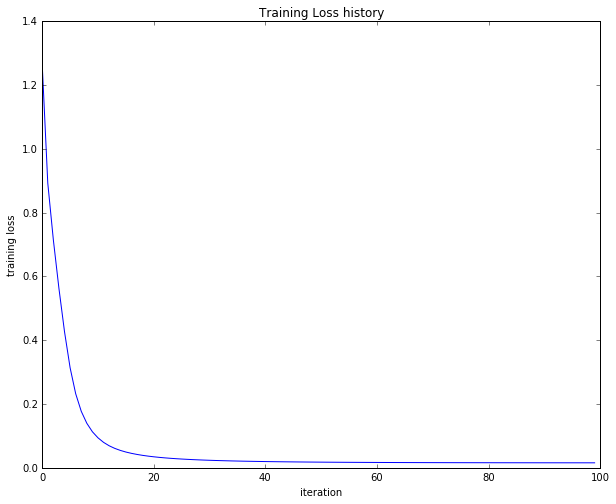

In [43]:
net = init_toy_model()
stats = net.train(X, y, X, y,
            learning_rate=1e-1, reg=1e-5,
            num_iters=100, verbose=False)

print 'Final training loss: ', stats['loss_history'][-1]

# plot the loss history
plt.plot(stats['loss_history'])
plt.xlabel('iteration')
plt.ylabel('training loss')
plt.title('Training Loss history')
plt.show()

In [8]:
from cs231n.data_utils import load_CIFAR10

def get_CIFAR10_data(num_training=49000, num_validation=1000, num_test=1000):
    """
    Load the CIFAR-10 dataset from disk and perform preprocessing to prepare
    it for the two-layer neural net classifier. These are the same steps as
    we used for the SVM, but condensed to a single function.  
    """
    # Load the raw CIFAR-10 data
    cifar10_dir = 'cs231n/datasets/cifar-10-batches-py'
    X_train, y_train, X_test, y_test = load_CIFAR10(cifar10_dir)
        
    # Subsample the data
    mask = range(num_training, num_training + num_validation)
    X_val = X_train[mask]
    y_val = y_train[mask]
    mask = range(num_training)
    X_train = X_train[mask]
    y_train = y_train[mask]
    mask = range(num_test)
    X_test = X_test[mask]
    y_test = y_test[mask]

    # Normalize the data: subtract the mean image
    mean_image = np.mean(X_train, axis=0)
    X_train -= mean_image
    X_val -= mean_image
    X_test -= mean_image

    # Reshape data to rows
    X_train = X_train.reshape(num_training, -1)
    X_val = X_val.reshape(num_validation, -1)
    X_test = X_test.reshape(num_test, -1)

    return X_train, y_train, X_val, y_val, X_test, y_test


# Invoke the above function to get our data.
X_train, y_train, X_val, y_val, X_test, y_test = get_CIFAR10_data()
print 'Train data shape: ', X_train.shape
print 'Train labels shape: ', y_train.shape
print 'Validation data shape: ', X_val.shape
print 'Validation labels shape: ', y_val.shape
print 'Test data shape: ', X_test.shape
print 'Test labels shape: ', y_test.shape

Train data shape:  (49000, 3072)
Train labels shape:  (49000,)
Validation data shape:  (1000, 3072)
Validation labels shape:  (1000,)
Test data shape:  (1000, 3072)
Test labels shape:  (1000,)


# Train a network
To train our network we will use SGD with momentum. In addition, we will adjust the learning rate with an exponential learning rate schedule as optimization proceeds; after each epoch, we will reduce the learning rate by multiplying it by a decay rate.

In [44]:
input_size = 32 * 32 * 3
hidden_size = 50
num_classes = 10
net = TwoLayerNet(input_size, hidden_size, num_classes)

# Train the network
stats = net.train(X_train, y_train, X_val, y_val,
            num_iters=1000, batch_size=200,
            learning_rate=1e-4, learning_rate_decay=0.95,
            reg=0.5, verbose=True)

# Predict on the validation set
val_acc = (net.predict(X_val) == y_val).mean()
print 'Validation accuracy: ', val_acc



iteration 0 / 1000: loss 2.302939
iteration 100 / 1000: loss 2.302427
iteration 200 / 1000: loss 2.298095
iteration 300 / 1000: loss 2.253179
iteration 400 / 1000: loss 2.152041
iteration 500 / 1000: loss 2.115062
iteration 600 / 1000: loss 2.067323
iteration 700 / 1000: loss 2.031150
iteration 800 / 1000: loss 1.968564
iteration 900 / 1000: loss 1.962258
Validation accuracy:  0.29


# Debug the training
With the default parameters we provided above, you should get a validation accuracy of about 0.29 on the validation set. This isn't very good.

One strategy for getting insight into what's wrong is to plot the loss function and the accuracies on the training and validation sets during optimization.

Another strategy is to visualize the weights that were learned in the first layer of the network. In most neural networks trained on visual data, the first layer weights typically show some visible structure when visualized.

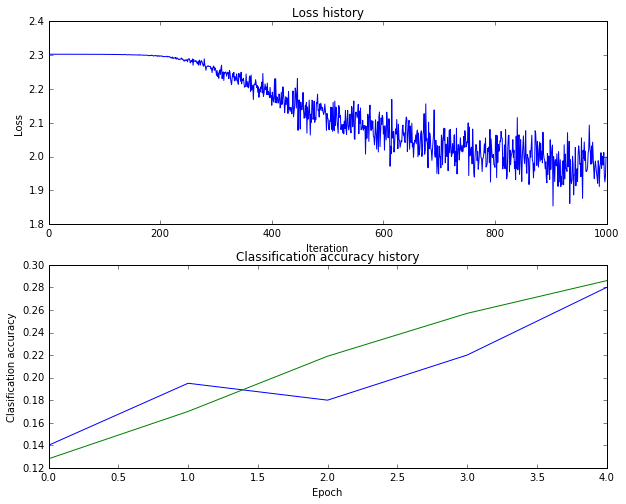

In [45]:
# Plot the loss function and train / validation accuracies
plt.subplot(2, 1, 1)
plt.plot(stats['loss_history'])
plt.title('Loss history')
plt.xlabel('Iteration')
plt.ylabel('Loss')

plt.subplot(2, 1, 2)
plt.plot(stats['train_acc_history'], label='train')
plt.plot(stats['val_acc_history'], label='val')
plt.title('Classification accuracy history')
plt.xlabel('Epoch')
plt.ylabel('Clasification accuracy')
plt.show()

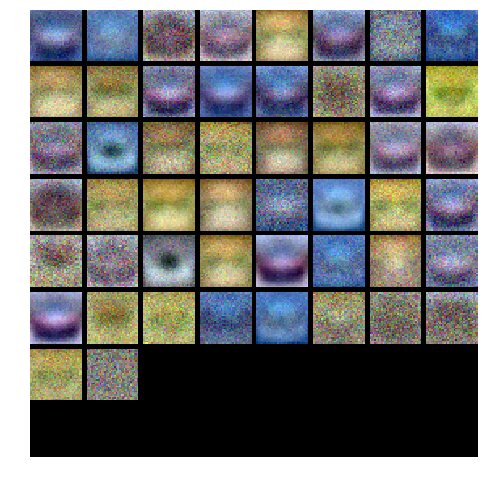

In [46]:
from cs231n.vis_utils import visualize_grid

# Visualize the weights of the network

def show_net_weights(net):
  W1 = net.params['W1']
  W1 = W1.reshape(32, 32, 3, -1).transpose(3, 0, 1, 2)
  plt.imshow(visualize_grid(W1, padding=3).astype('uint8'))
  plt.gca().axis('off')
  plt.show()

show_net_weights(net)

# Tune your hyperparameters

**What's wrong?**. Looking at the visualizations above, we see that the loss is decreasing more or less linearly, which seems to suggest that the learning rate may be too low. Moreover, there is no gap between the training and validation accuracy, suggesting that the model we used has low capacity, and that we should increase its size. On the other hand, with a very large model we would expect to see more overfitting, which would manifest itself as a very large gap between the training and validation accuracy.

**Tuning**. Tuning the hyperparameters and developing intuition for how they affect the final performance is a large part of using Neural Networks, so we want you to get a lot of practice. Below, you should experiment with different values of the various hyperparameters, including hidden layer size, learning rate, numer of training epochs, and regularization strength. You might also consider tuning the learning rate decay, but you should be able to get good performance using the default value.

**Approximate results**. You should be aim to achieve a classification accuracy of greater than 48% on the validation set. Our best network gets over 52% on the validation set.

**Experiment**: You goal in this exercise is to get as good of a result on CIFAR-10 as you can, with a fully-connected Neural Network. For every 1% above 52% on the Test set we will award you with one extra bonus point. Feel free implement your own techniques (e.g. PCA to reduce dimensionality, or adding dropout, or adding features to the solver, etc.).

Size = 93, Learning rate = 5.903396e-04, Reg. Strength = 1.854023e+00
iteration 0 / 400: loss 2.305246
iteration 100 / 400: loss 2.128739
iteration 200 / 400: loss 2.012619
iteration 300 / 400: loss 1.881901


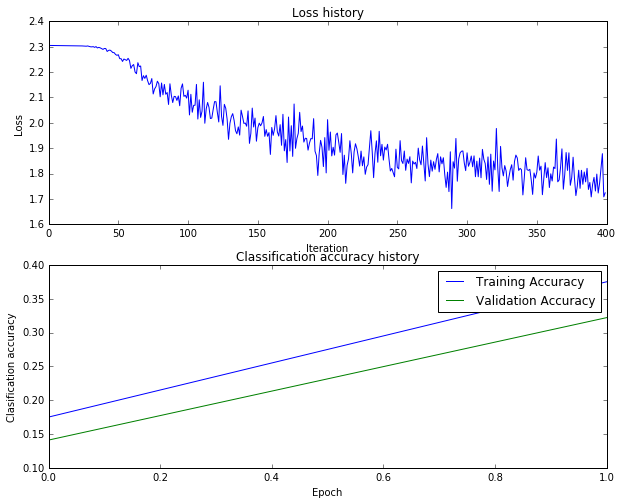

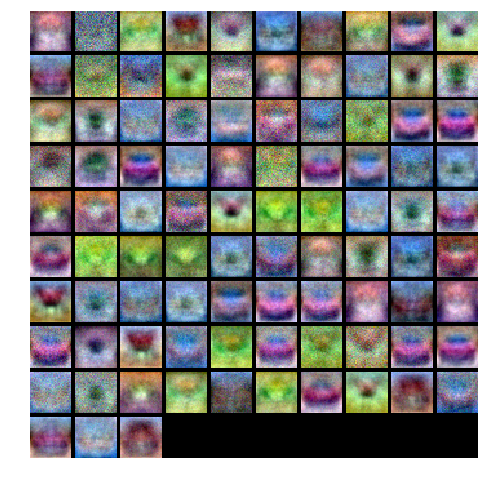

Size = 93, Learning rate = 5.903396e-04, Reg. Strength = 1.585470e-04
iteration 0 / 400: loss 2.302603
iteration 100 / 400: loss 2.071707
iteration 200 / 400: loss 1.916065
iteration 300 / 400: loss 1.886250


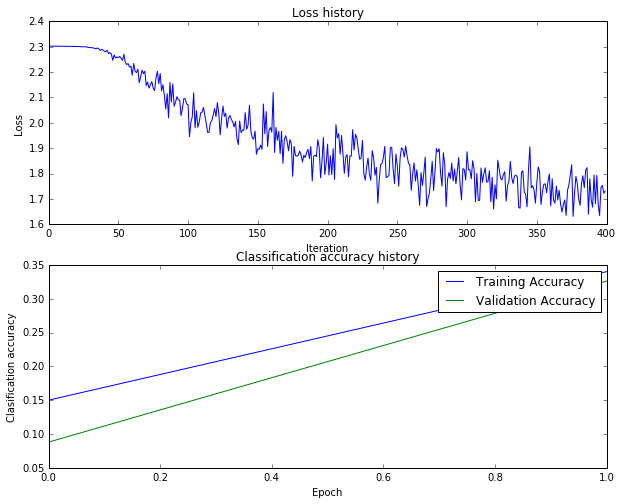

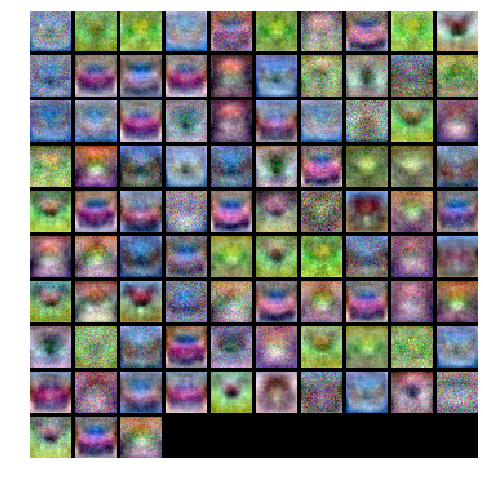

Size = 93, Learning rate = 5.903396e-04, Reg. Strength = 3.018153e-01
iteration 0 / 400: loss 2.302994
iteration 100 / 400: loss 2.033154
iteration 200 / 400: loss 1.906319
iteration 300 / 400: loss 1.780955


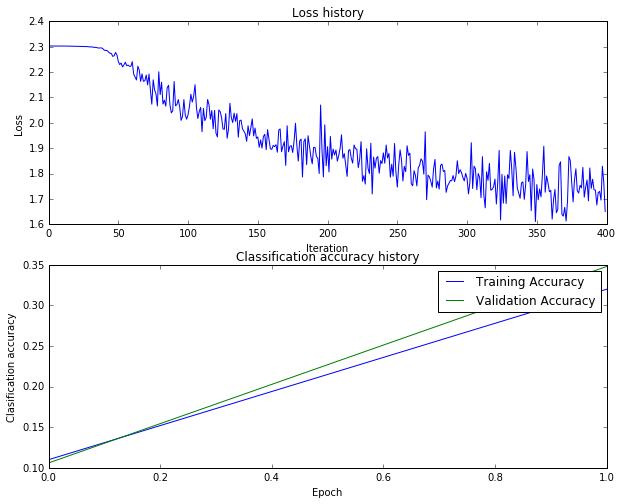

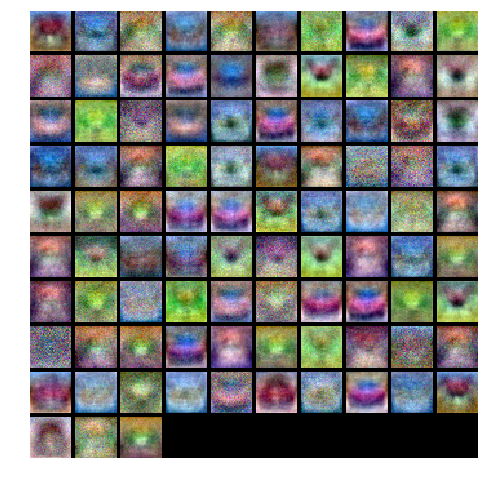

Size = 93, Learning rate = 5.903396e-04, Reg. Strength = 1.160004e-03
iteration 0 / 400: loss 2.302642
iteration 100 / 400: loss 2.056343
iteration 200 / 400: loss 1.814857
iteration 300 / 400: loss 1.812947


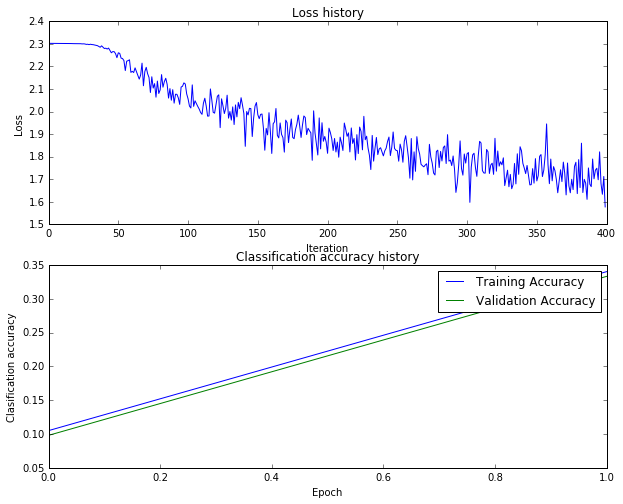

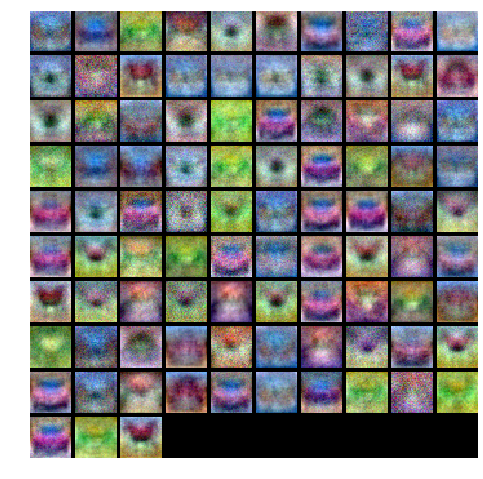

Size = 93, Learning rate = 5.903396e-04, Reg. Strength = 8.369624e-05
iteration 0 / 400: loss 2.302583
iteration 100 / 400: loss 2.076213
iteration 200 / 400: loss 1.936156
iteration 300 / 400: loss 1.724011


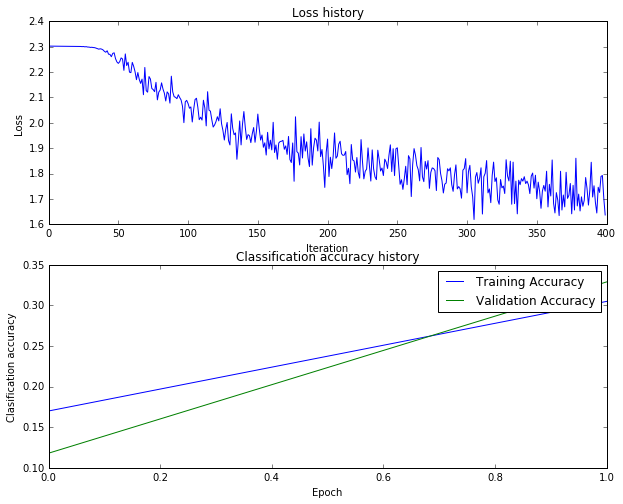

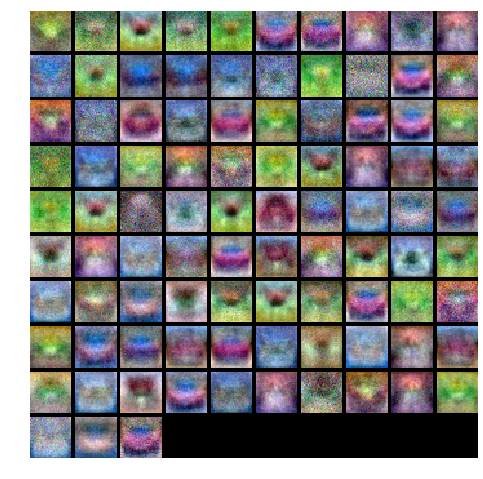

Size = 93, Learning rate = 1.971939e-04, Reg. Strength = 1.854023e+00
iteration 0 / 400: loss 2.305252
iteration 100 / 400: loss 2.298355
iteration 200 / 400: loss 2.169345
iteration 300 / 400: loss 2.106971


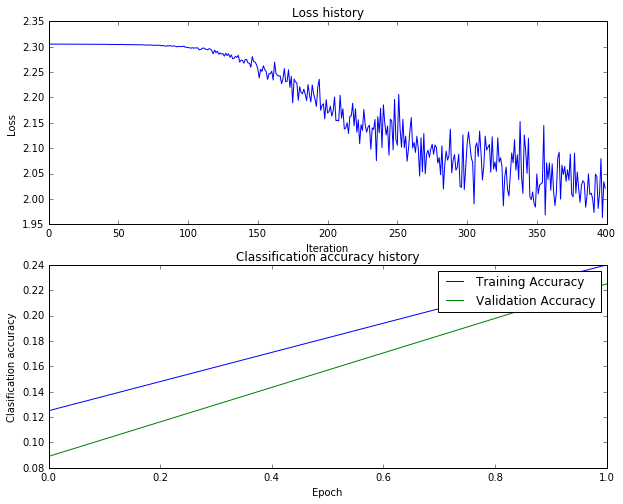

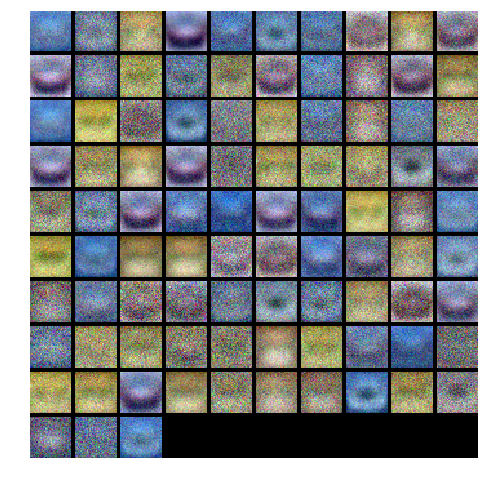

Size = 93, Learning rate = 1.971939e-04, Reg. Strength = 1.585470e-04
iteration 0 / 400: loss 2.302581
iteration 100 / 400: loss 2.294492
iteration 200 / 400: loss 2.146659
iteration 300 / 400: loss 2.075935


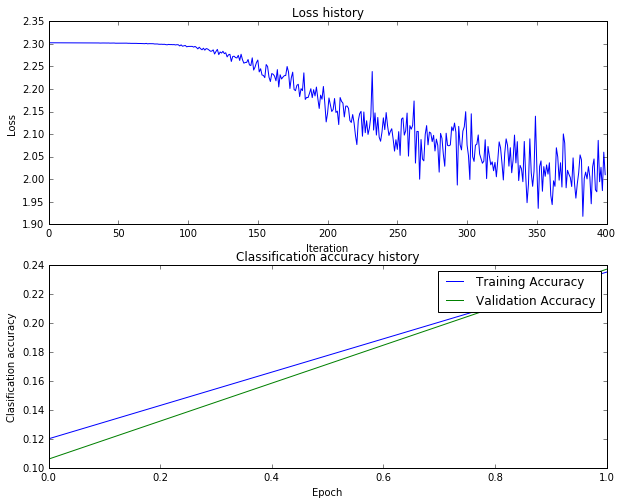

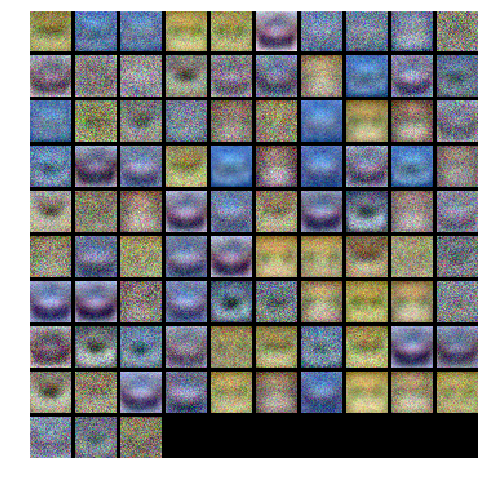

Size = 93, Learning rate = 1.971939e-04, Reg. Strength = 3.018153e-01
iteration 0 / 400: loss 2.303022
iteration 100 / 400: loss 2.293476
iteration 200 / 400: loss 2.152233
iteration 300 / 400: loss 2.056260


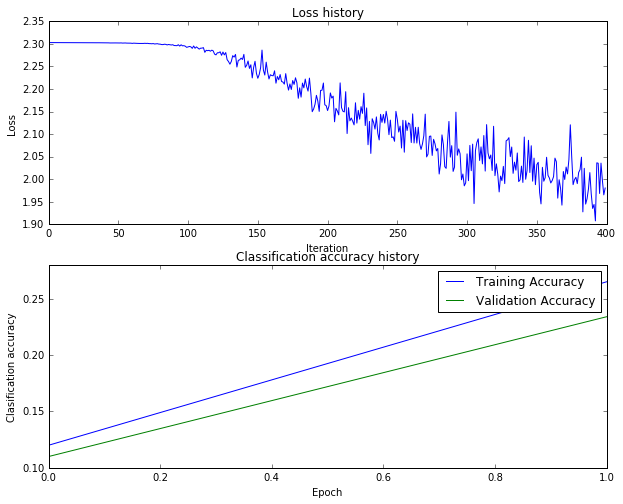

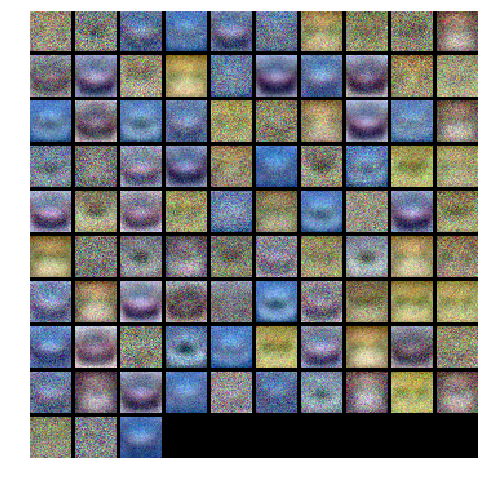

Size = 93, Learning rate = 1.971939e-04, Reg. Strength = 1.160004e-03
iteration 0 / 400: loss 2.302600
iteration 100 / 400: loss 2.294206
iteration 200 / 400: loss 2.171181
iteration 300 / 400: loss 2.087134


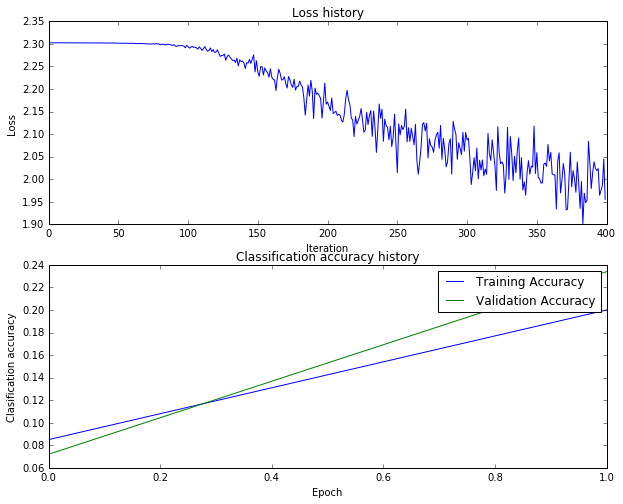

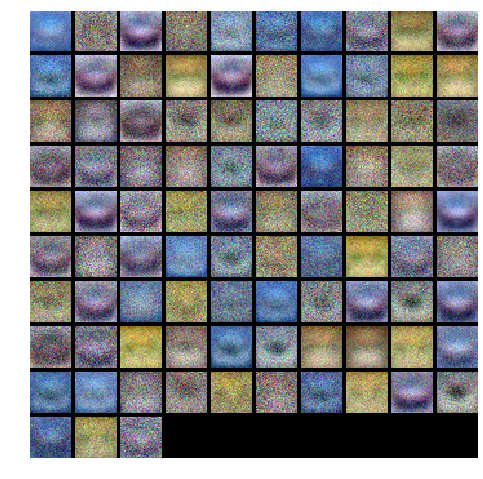

Size = 93, Learning rate = 1.971939e-04, Reg. Strength = 8.369624e-05
iteration 0 / 400: loss 2.302620
iteration 100 / 400: loss 2.295847
iteration 200 / 400: loss 2.206062
iteration 300 / 400: loss 2.042446


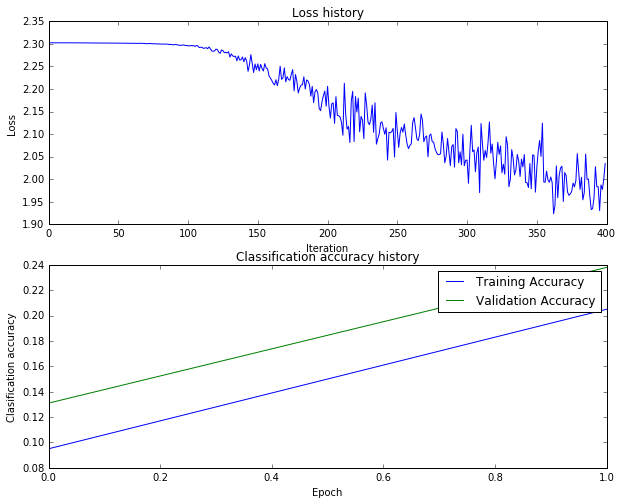

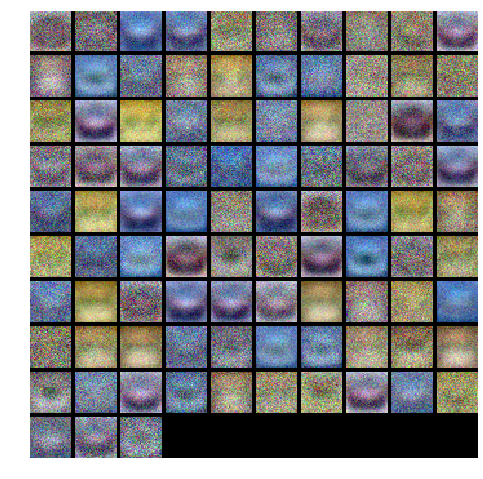

Size = 93, Learning rate = 1.136119e-02, Reg. Strength = 1.854023e+00
iteration 0 / 400: loss 2.305236
iteration 100 / 400: loss nan
iteration 200 / 400: loss nan
iteration 300 / 400: loss nan


cs231n/classifiers/neural_net.py:135: RuntimeWarning: divide by zero encountered in log
  loss = np.sum(-np.log(correct_class_scores))
cs231n/classifiers/neural_net.py:128: RuntimeWarning: invalid value encountered in divide
  softmax_scores = (exp_scores.T / sum_exp_scores).T
cs231n/classifiers/neural_net.py:175: RuntimeWarning: invalid value encountered in greater_equal
  dX_1_dot_W1_b1 = (X_1.dot(W1_b1) >= 0) * dh1


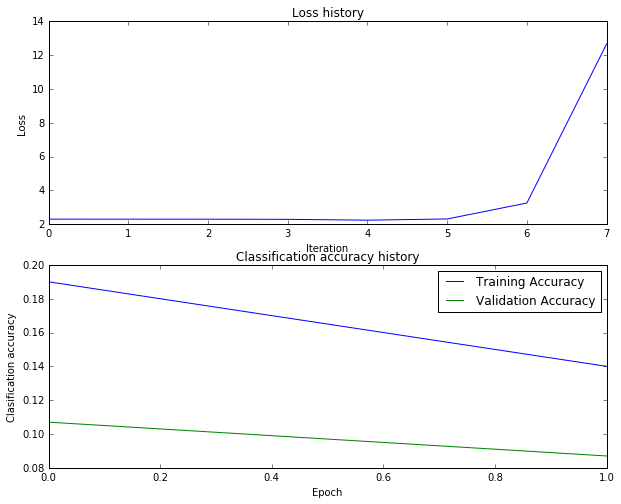

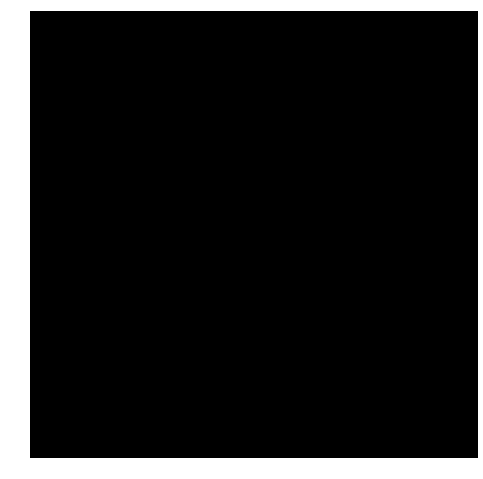

Size = 93, Learning rate = 1.136119e-02, Reg. Strength = 1.585470e-04
iteration 0 / 400: loss 2.302588
iteration 100 / 400: loss nan
iteration 200 / 400: loss nan
iteration 300 / 400: loss nan


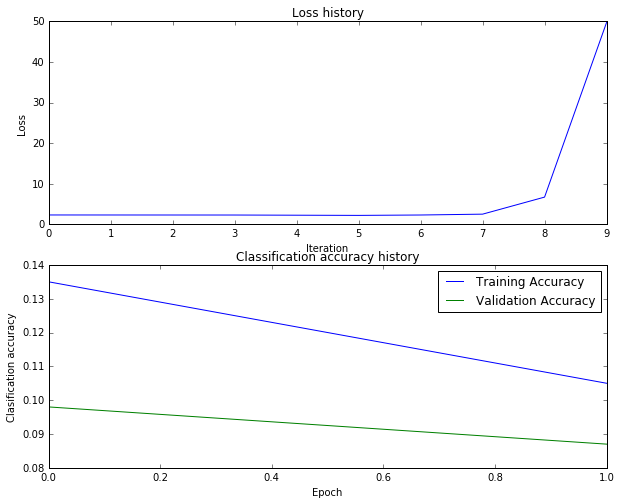

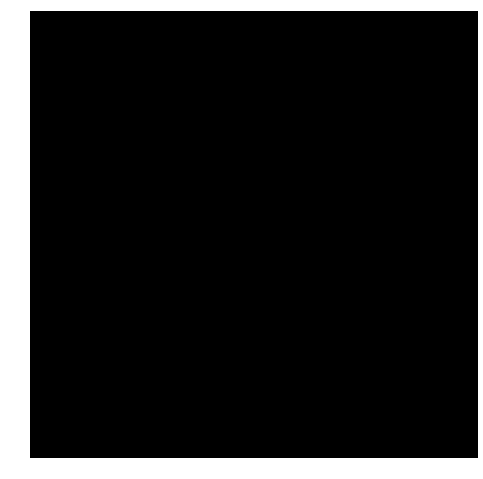

Size = 93, Learning rate = 1.136119e-02, Reg. Strength = 3.018153e-01
iteration 0 / 400: loss 2.303013
iteration 100 / 400: loss nan
iteration 200 / 400: loss nan
iteration 300 / 400: loss nan


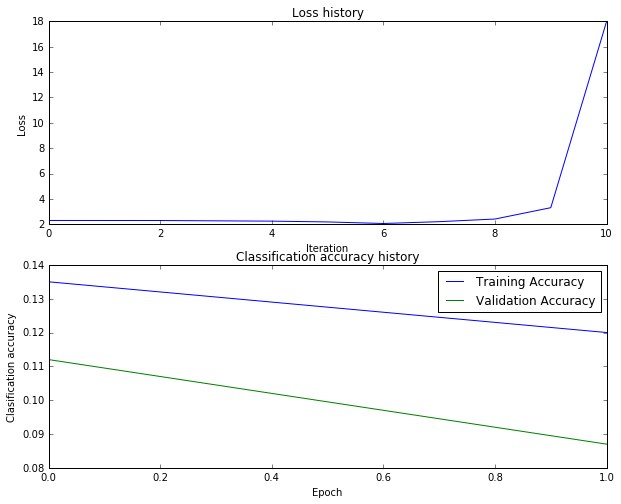

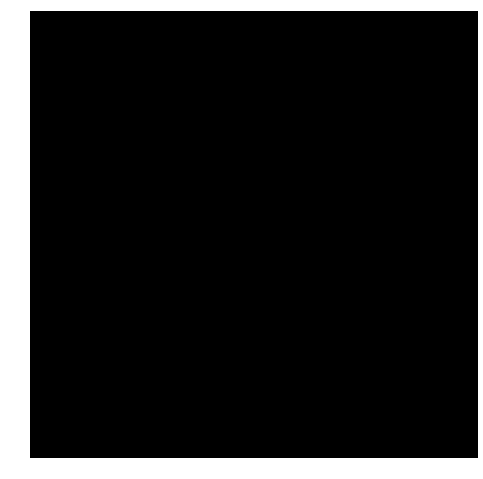

Size = 93, Learning rate = 1.136119e-02, Reg. Strength = 1.160004e-03
iteration 0 / 400: loss 2.302567
iteration 100 / 400: loss nan
iteration 200 / 400: loss nan
iteration 300 / 400: loss nan


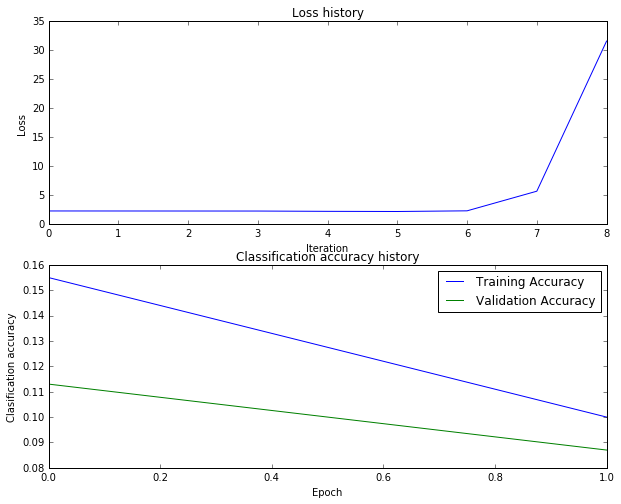

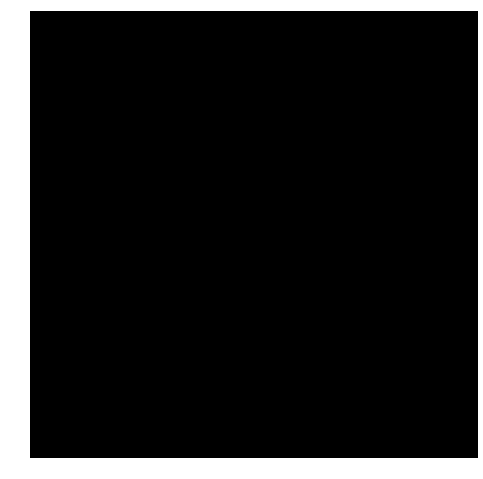

Size = 93, Learning rate = 1.136119e-02, Reg. Strength = 8.369624e-05
iteration 0 / 400: loss 2.302598
iteration 100 / 400: loss nan
iteration 200 / 400: loss nan
iteration 300 / 400: loss nan


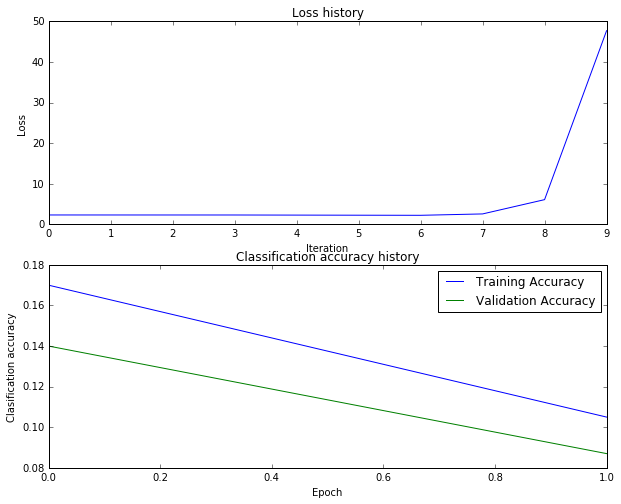

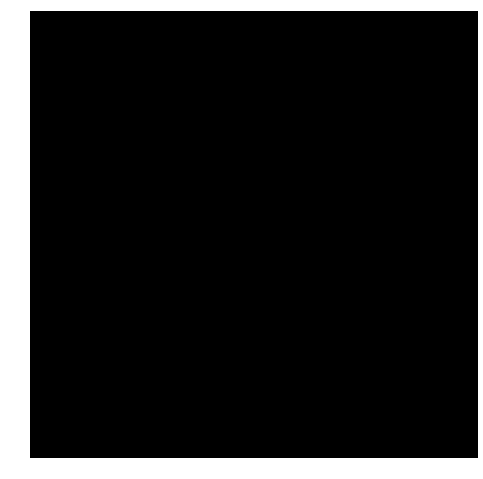

Size = 93, Learning rate = 1.670386e-04, Reg. Strength = 1.854023e+00
iteration 0 / 400: loss 2.305240
iteration 100 / 400: loss 2.302512
iteration 200 / 400: loss 2.214939
iteration 300 / 400: loss 2.130413


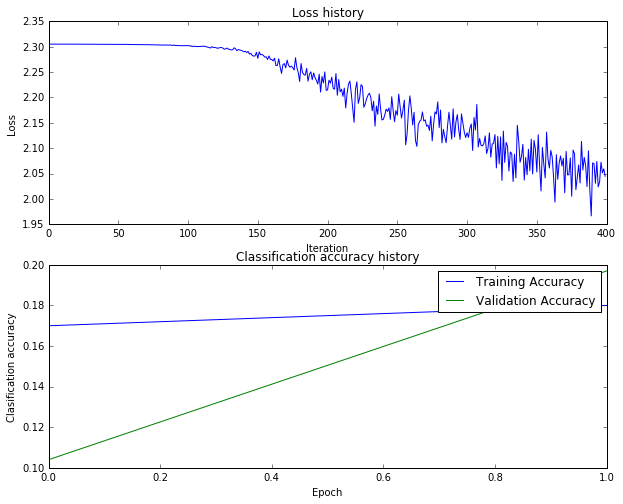

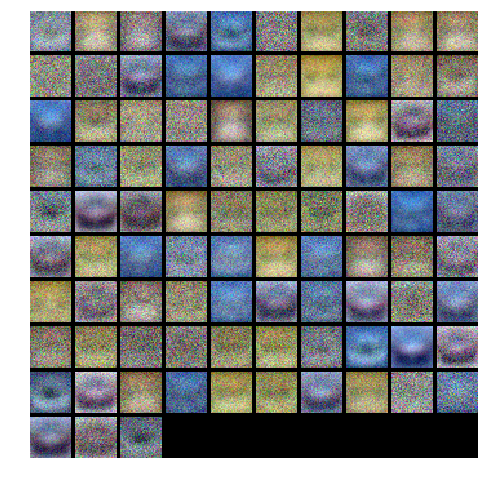

Size = 93, Learning rate = 1.670386e-04, Reg. Strength = 1.585470e-04
iteration 0 / 400: loss 2.302582
iteration 100 / 400: loss 2.299092
iteration 200 / 400: loss 2.186658
iteration 300 / 400: loss 2.150418


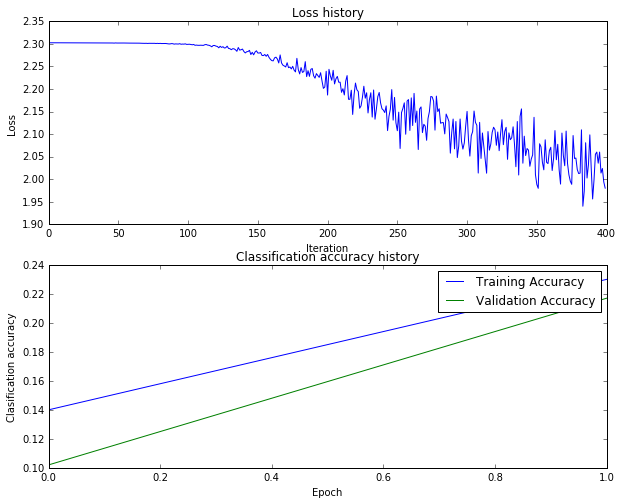

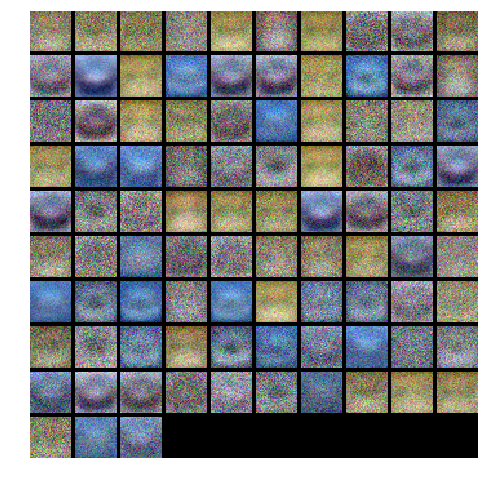

Size = 93, Learning rate = 1.670386e-04, Reg. Strength = 3.018153e-01
iteration 0 / 400: loss 2.302994
iteration 100 / 400: loss 2.300083
iteration 200 / 400: loss 2.226337
iteration 300 / 400: loss 2.133989


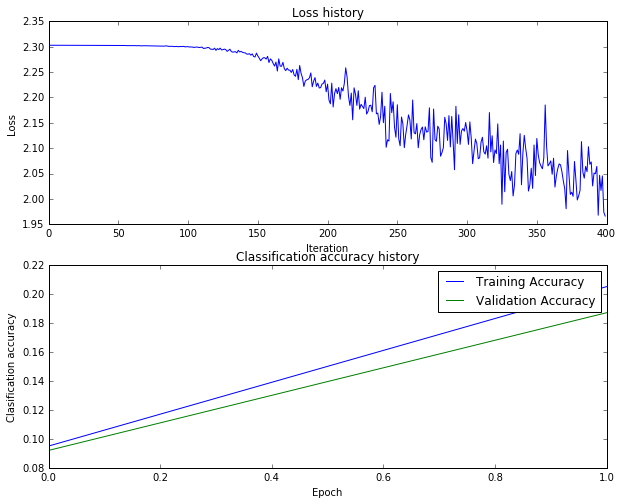

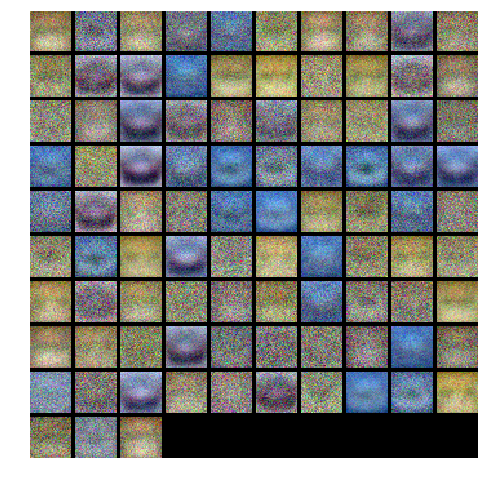

Size = 93, Learning rate = 1.670386e-04, Reg. Strength = 1.160004e-03
iteration 0 / 400: loss 2.302570
iteration 100 / 400: loss 2.298542
iteration 200 / 400: loss 2.224807
iteration 300 / 400: loss 2.134214


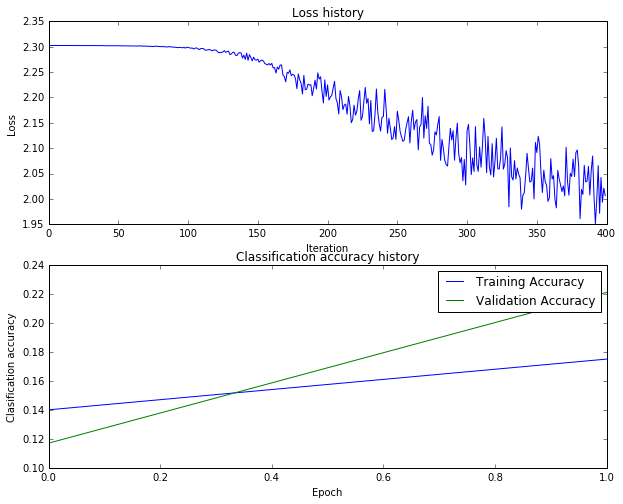

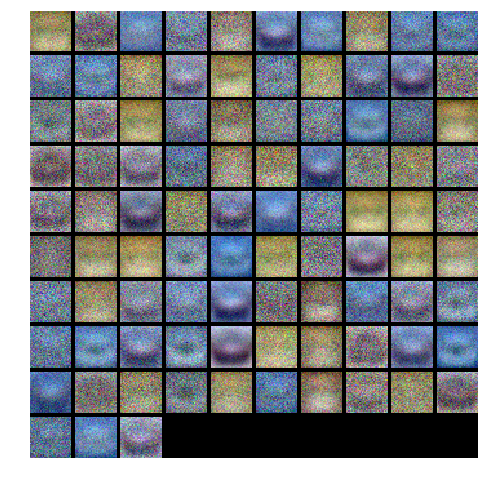

Size = 93, Learning rate = 1.670386e-04, Reg. Strength = 8.369624e-05
iteration 0 / 400: loss 2.302583
iteration 100 / 400: loss 2.297926
iteration 200 / 400: loss 2.217114
iteration 300 / 400: loss 2.039166


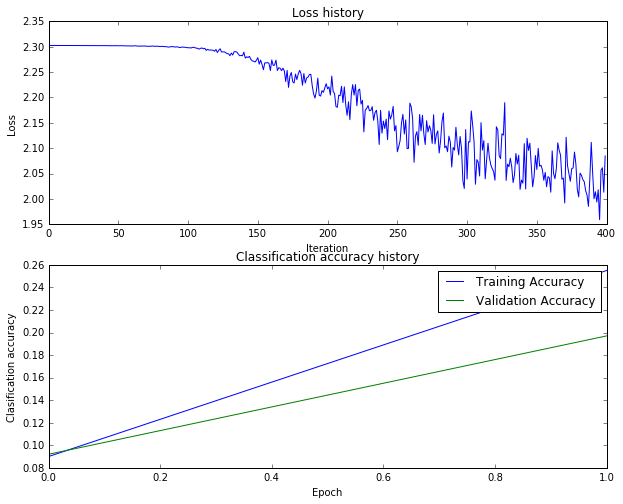

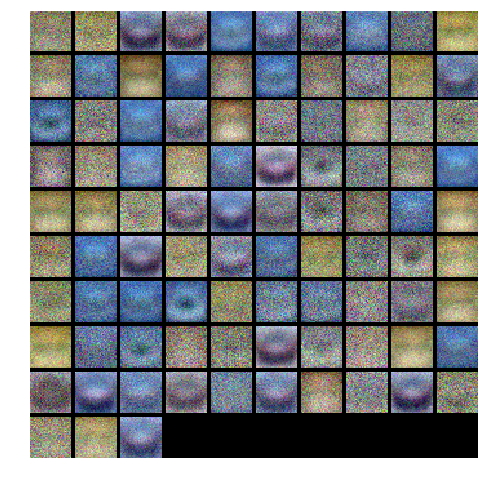

Size = 93, Learning rate = 8.774945e-02, Reg. Strength = 1.854023e+00
iteration 0 / 400: loss 2.305218
iteration 100 / 400: loss nan
iteration 200 / 400: loss nan
iteration 300 / 400: loss nan


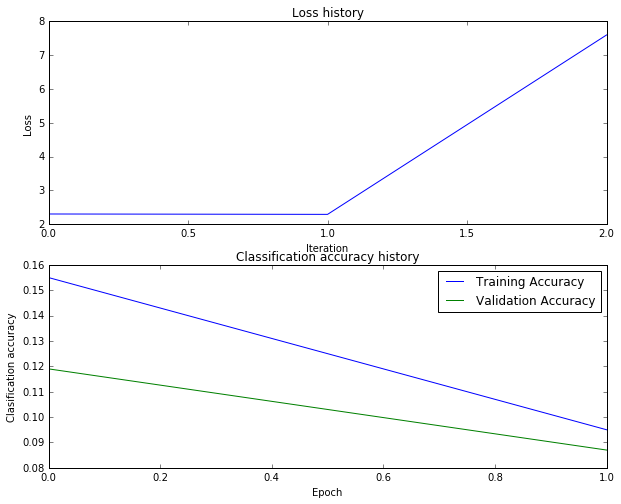

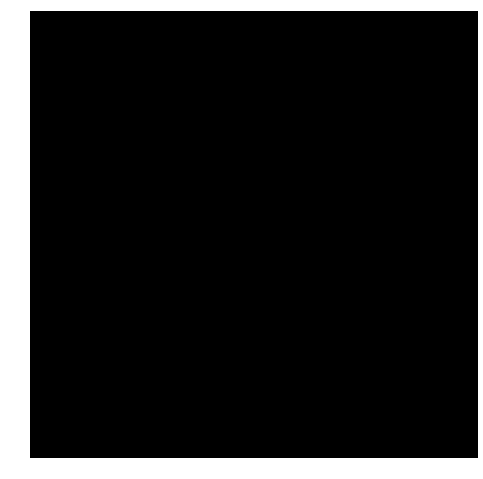

Size = 93, Learning rate = 8.774945e-02, Reg. Strength = 1.585470e-04
iteration 0 / 400: loss 2.302602
iteration 100 / 400: loss nan
iteration 200 / 400: loss nan
iteration 300 / 400: loss nan


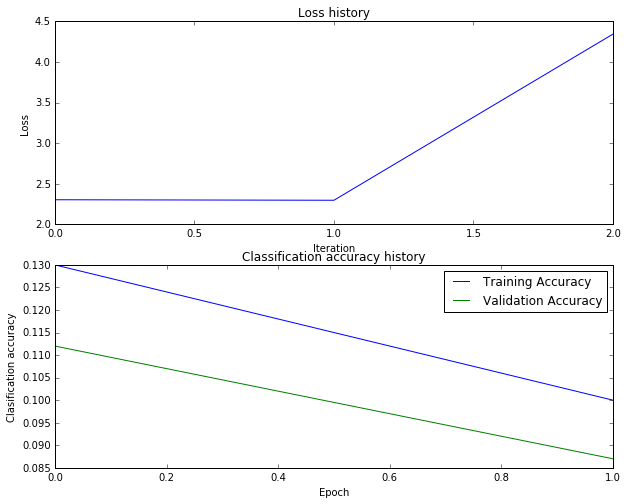

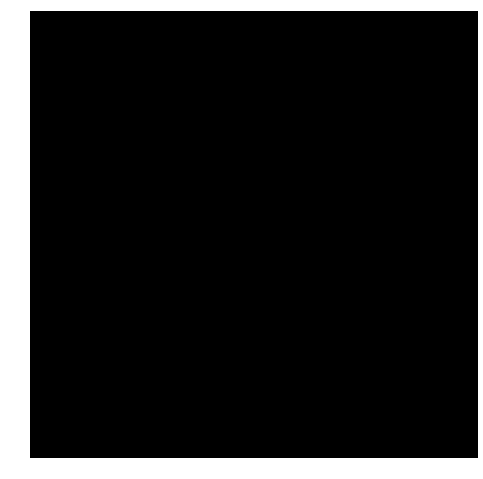

Size = 93, Learning rate = 8.774945e-02, Reg. Strength = 3.018153e-01
iteration 0 / 400: loss 2.302976
iteration 100 / 400: loss nan
iteration 200 / 400: loss nan
iteration 300 / 400: loss nan


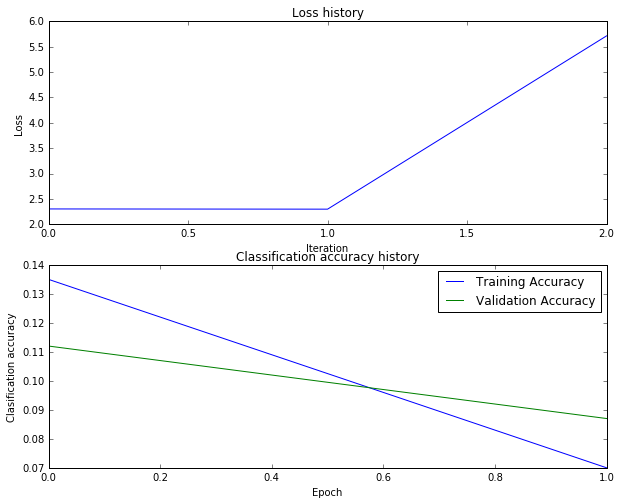

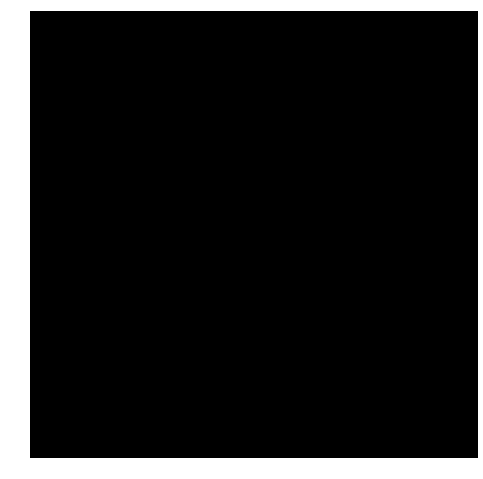

Size = 93, Learning rate = 8.774945e-02, Reg. Strength = 1.160004e-03
iteration 0 / 400: loss 2.302546
iteration 100 / 400: loss nan
iteration 200 / 400: loss nan
iteration 300 / 400: loss nan


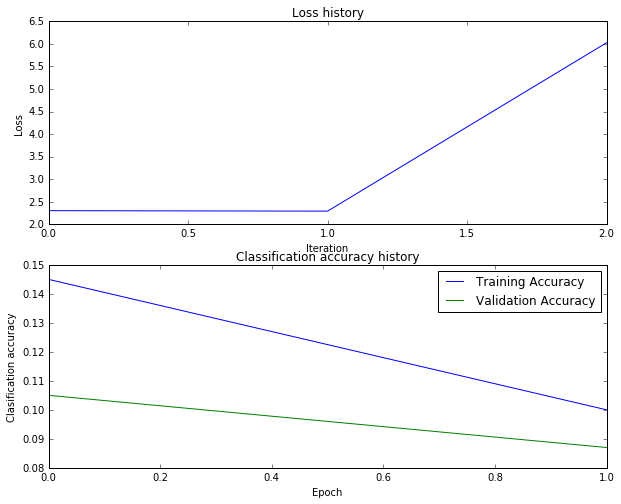

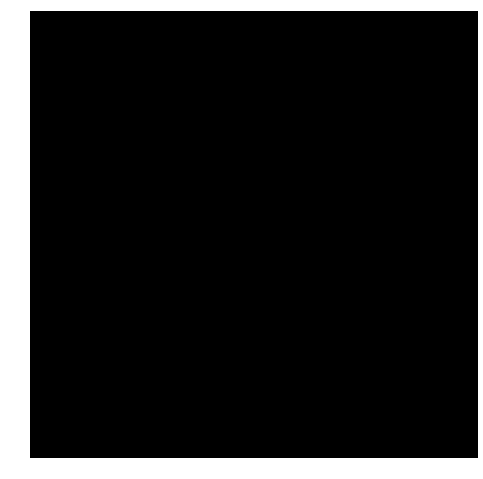

Size = 93, Learning rate = 8.774945e-02, Reg. Strength = 8.369624e-05
iteration 0 / 400: loss 2.302576
iteration 100 / 400: loss nan
iteration 200 / 400: loss nan
iteration 300 / 400: loss nan


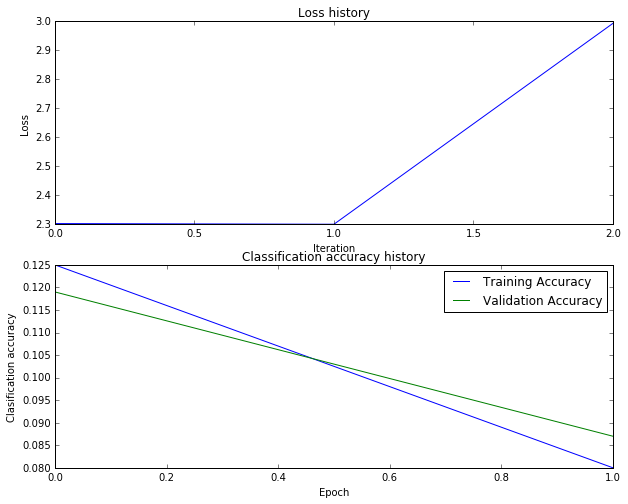

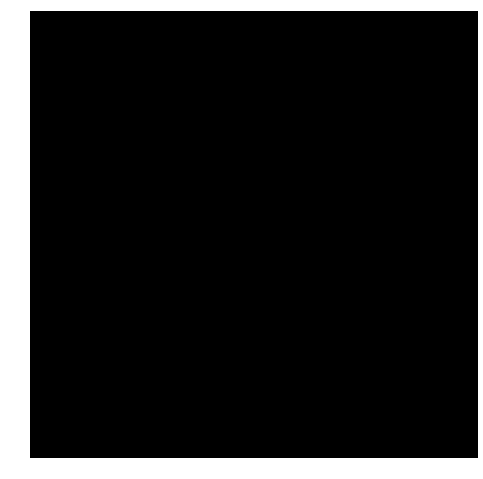

Size = 123, Learning rate = 5.903396e-04, Reg. Strength = 1.854023e+00
iteration 0 / 400: loss 2.306129
iteration 100 / 400: loss 2.098460
iteration 200 / 400: loss 2.007629
iteration 300 / 400: loss 1.860316


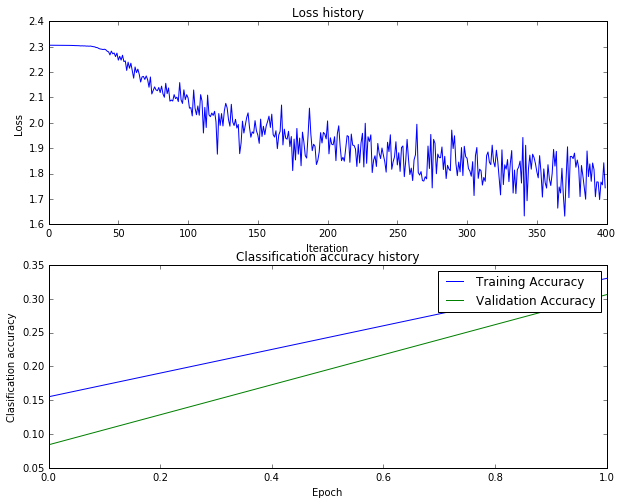

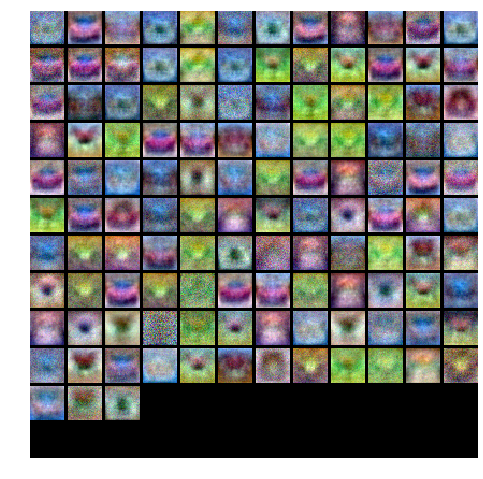

Size = 123, Learning rate = 5.903396e-04, Reg. Strength = 1.585470e-04
iteration 0 / 400: loss 2.302616
iteration 100 / 400: loss 2.042114
iteration 200 / 400: loss 1.959330
iteration 300 / 400: loss 1.798227


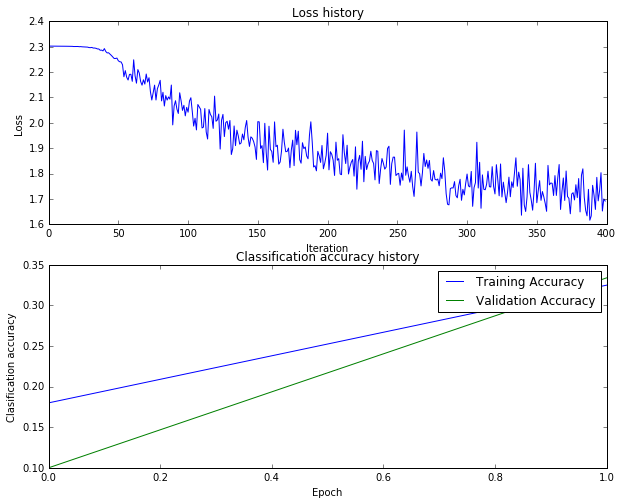

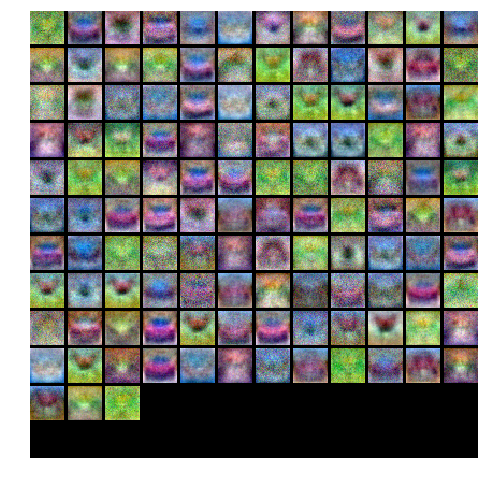

Size = 123, Learning rate = 5.903396e-04, Reg. Strength = 3.018153e-01
iteration 0 / 400: loss 2.303172
iteration 100 / 400: loss 2.007636
iteration 200 / 400: loss 1.858393
iteration 300 / 400: loss 1.680117


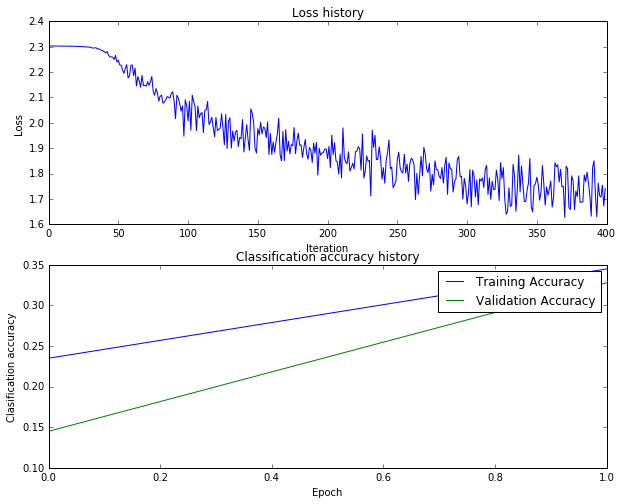

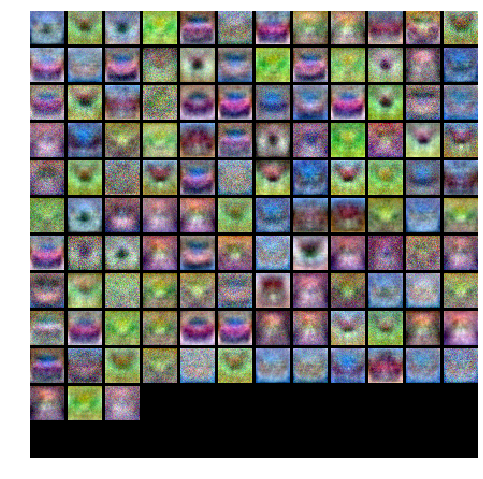

Size = 123, Learning rate = 5.903396e-04, Reg. Strength = 1.160004e-03
iteration 0 / 400: loss 2.302563
iteration 100 / 400: loss 2.019234
iteration 200 / 400: loss 1.894474
iteration 300 / 400: loss 1.791230


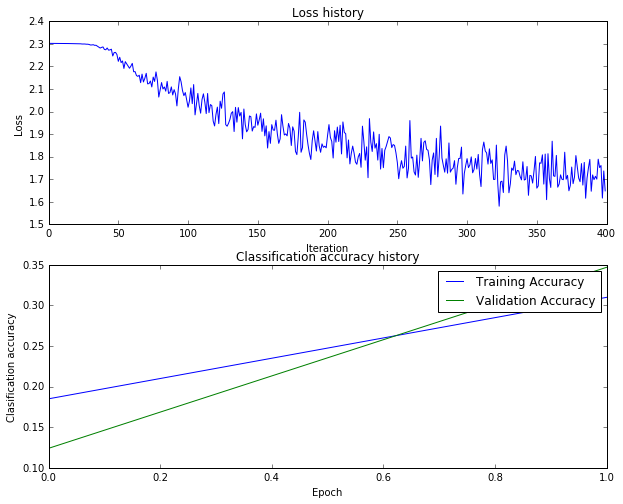

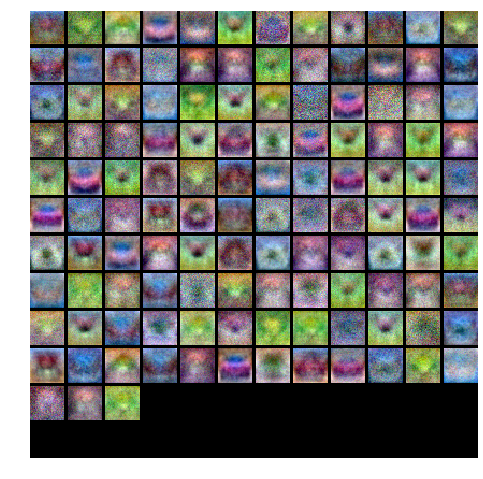

Size = 123, Learning rate = 5.903396e-04, Reg. Strength = 8.369624e-05
iteration 0 / 400: loss 2.302581
iteration 100 / 400: loss 2.061630
iteration 200 / 400: loss 1.875998
iteration 300 / 400: loss 1.785009


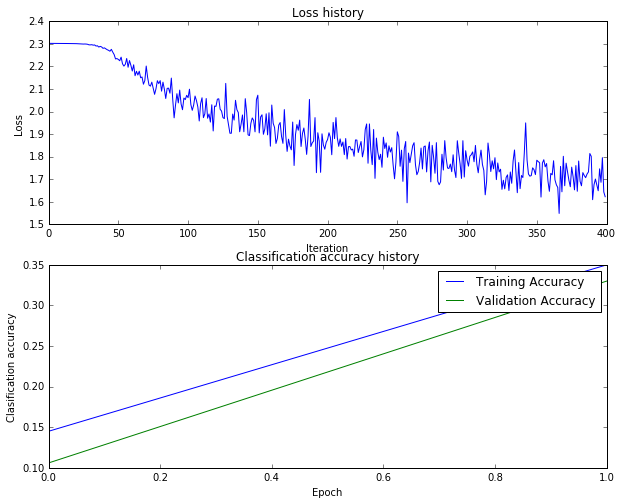

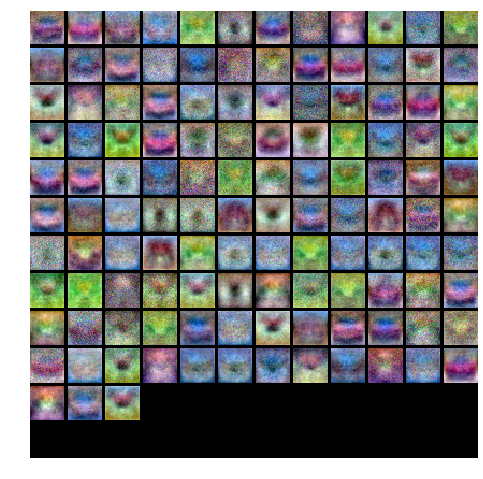

Size = 123, Learning rate = 1.971939e-04, Reg. Strength = 1.854023e+00
iteration 0 / 400: loss 2.306123
iteration 100 / 400: loss 2.296966
iteration 200 / 400: loss 2.196529
iteration 300 / 400: loss 2.008922


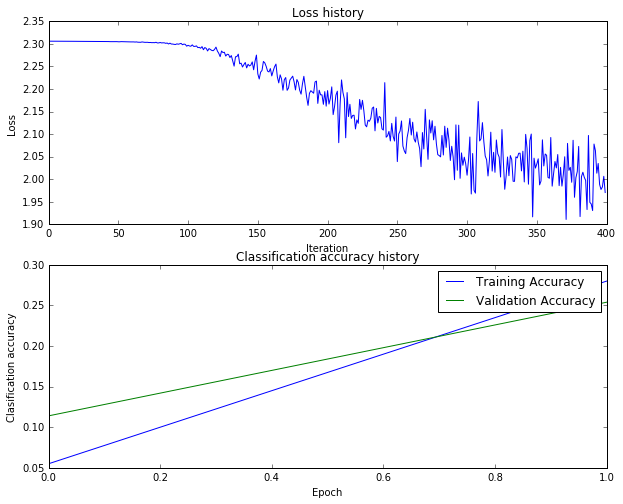

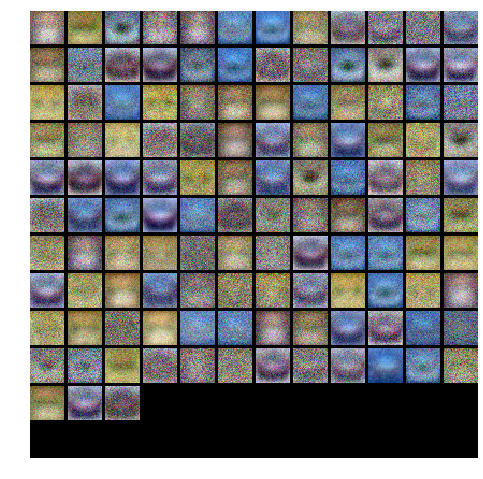

Size = 123, Learning rate = 1.971939e-04, Reg. Strength = 1.585470e-04
iteration 0 / 400: loss 2.302587
iteration 100 / 400: loss 2.292700
iteration 200 / 400: loss 2.156514
iteration 300 / 400: loss 2.024982


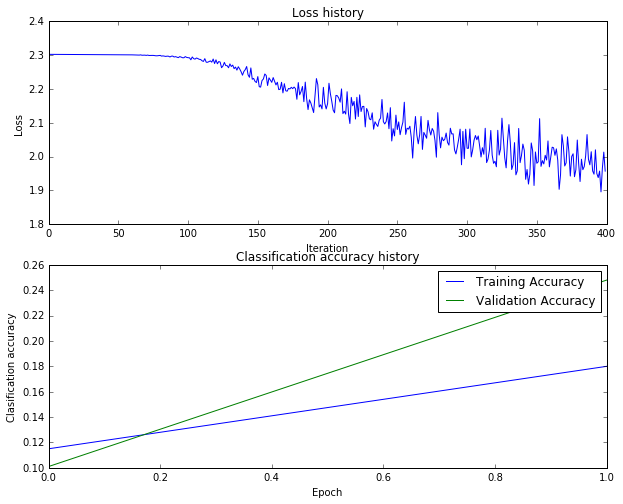

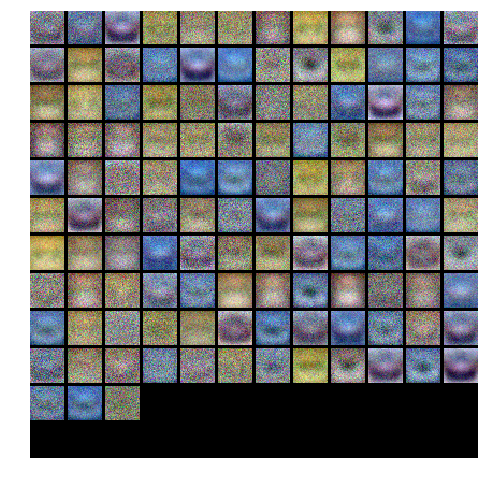

Size = 123, Learning rate = 1.971939e-04, Reg. Strength = 3.018153e-01
iteration 0 / 400: loss 2.303108
iteration 100 / 400: loss 2.292682
iteration 200 / 400: loss 2.155376
iteration 300 / 400: loss 2.029151


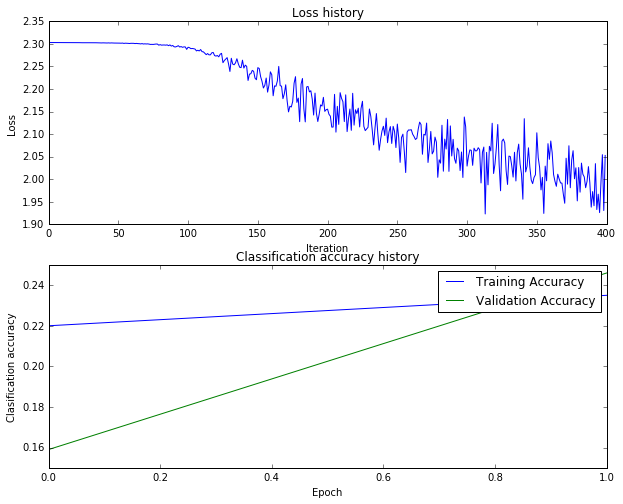

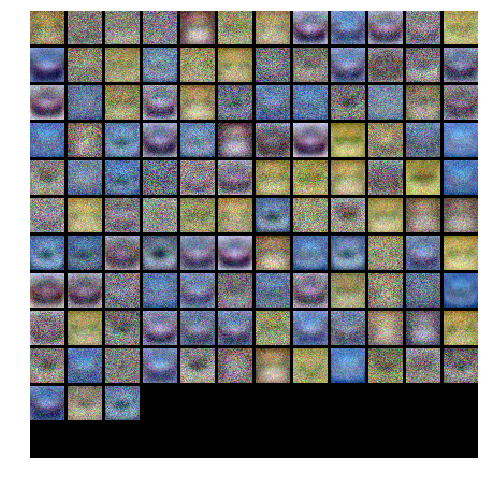

Size = 123, Learning rate = 1.971939e-04, Reg. Strength = 1.160004e-03
iteration 0 / 400: loss 2.302571
iteration 100 / 400: loss 2.289803
iteration 200 / 400: loss 2.171010
iteration 300 / 400: loss 2.066326


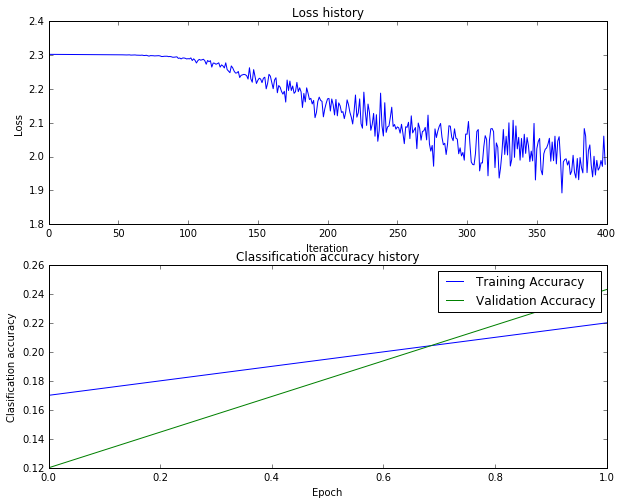

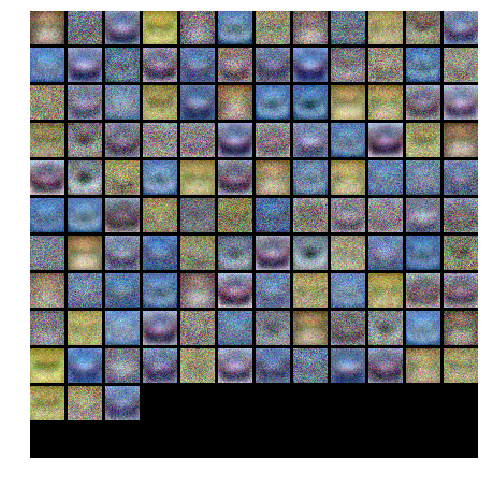

Size = 123, Learning rate = 1.971939e-04, Reg. Strength = 8.369624e-05
iteration 0 / 400: loss 2.302550
iteration 100 / 400: loss 2.293100
iteration 200 / 400: loss 2.186681


KeyboardInterrupt: 

In [12]:
# best_net = None # store the best model into this 

#################################################################################
# TODO: Tune hyperparameters using the validation set. Store your best trained  #
# model in best_net.                                                            #
#                                                                               #
# To help debug your network, it may help to use visualizations similar to the  #
# ones we used above; these visualizations will have significant qualitative    #
# differences from the ones we saw above for the poorly tuned network.          #
#                                                                               #
# Tweaking hyperparameters by hand can be fun, but you might find it useful to  #
# write code to sweep through possible combinations of hyperparameters          #
# automatically like we did on the previous exercises.                          #
#################################################################################

stats = {}
results = {}
best_val = -1
best_stats = None

input_size = 32 * 32 * 3
num_classes = 10

# hidden_sizes = (100 * np.random.rand(5)).round().astype(int)
# learning_rates = (5e-3 - 5e-5) * np.random.rand(5) + 5e-5
# regularization_strengths = np.random.rand(5)

# hidden_sizes = [50, 75, 100]
# learning_rates = [5e-4]
# regularization_strengths = [0.65, 0.75, 0.85]

hidden_sizes = np.round(10 ** np.random.uniform(1.7,2.4,3)).astype(int)
learning_rates = 10 ** np.random.uniform(-5,-1,5)
regularization_strengths = 10 ** np.random.uniform(-5,5,5)

for hidden_size in hidden_sizes:
    
    for learning_rate in learning_rates:

        for regularization_strength in regularization_strengths:
            
            # Print hyperparameters
            print 'Size = %d, Learning rate = %e, Reg. Strength = %e' % (
                hidden_size, learning_rate, regularization_strength)

            # Initialize net
            net = TwoLayerNet(input_size, hidden_size, num_classes)

            # Training
            stats[hidden_size, learning_rate, regularization_strength] = \
                net.train(X_train, y_train, X_val, y_val,
                          num_iters=400, batch_size=200,
                          learning_rate=learning_rate, learning_rate_decay=0.95,
                          reg=regularization_strength, verbose=True)

            # Testing
            y_train_pred = net.predict(X_train)
            y_val_pred = net.predict(X_val)

            # Evaluation
            train_num_correct = np.sum(y_train_pred == y_train)
            training_accuracy = float(train_num_correct) / X_train.shape[0]

            val_num_correct = np.sum(y_val_pred == y_val)
            validation_accuracy = float(val_num_correct) / X_val.shape[0]

            results[hidden_size, learning_rate, regularization_strength] = training_accuracy, validation_accuracy

            if validation_accuracy > best_val:
                best_val = validation_accuracy
                best_net = net
                best_stats = stats[hidden_size, learning_rate, regularization_strength]
                
            current_stats = stats[hidden_size, learning_rate, regularization_strength]
                
            # Plot the loss function and train / validation accuracies
            plt.subplot(2, 1, 1)
            plt.plot(current_stats['loss_history'])
            plt.title('Loss history')
            plt.xlabel('Iteration')
            plt.ylabel('Loss')

            plt.subplot(2, 1, 2)
            train_acc, = plt.plot(current_stats['train_acc_history'], label='train')
            val_acc, = plt.plot(current_stats['val_acc_history'], label='val')
            plt.legend([train_acc, val_acc], ['Training Accuracy', 'Validation Accuracy'])
            plt.title('Classification accuracy history')
            plt.xlabel('Epoch')
            plt.ylabel('Clasification accuracy')
            plt.show()
            
            # visualize the weights of the current network
            show_net_weights(net)

pass

# Print out results.
for hid_size, lr, reg in sorted(results):
    train_accuracy, val_accuracy = results[(hid_size, lr, reg)]
    print 'size %d lr %e reg %e train accuracy: %f val accuracy: %f' % (
                hid_size, lr, reg, train_accuracy, val_accuracy)
    
print 'best validation accuracy achieved during cross-validation: %f' % best_val

# Plot the loss function and train / validation accuracies
plt.subplot(2, 1, 1)
plt.plot(best_stats['loss_history'])
plt.title('Loss history')
plt.xlabel('Iteration')
plt.ylabel('Loss')

plt.subplot(2, 1, 2)
train_acc, = plt.plot(best_stats['train_acc_history'], label='train')
val_acc, = plt.plot(best_stats['val_acc_history'], label='val')
plt.legend([train_acc, val_acc], ['Training Accuracy', 'Validation Accuracy'])
plt.title('Classification accuracy history')
plt.xlabel('Epoch')
plt.ylabel('Clasification accuracy')
plt.show()

# visualize the weights of the current network
show_net_weights(best_net)

pass
#################################################################################
#                               END OF YOUR CODE                                #
#################################################################################

Size = 100, Learning rate = 2.152304e-03, Reg. Strength = 6.163883e-02
iteration 0 / 2000: loss 2.302660
iteration 100 / 2000: loss 1.767646
iteration 200 / 2000: loss 1.691505
iteration 300 / 2000: loss 1.532047
iteration 400 / 2000: loss 1.489304
iteration 500 / 2000: loss 1.423505
iteration 600 / 2000: loss 1.392757
iteration 700 / 2000: loss 1.407929
iteration 800 / 2000: loss 1.409869
iteration 900 / 2000: loss 1.365366
iteration 1000 / 2000: loss 1.384495
iteration 1100 / 2000: loss 1.207875
iteration 1200 / 2000: loss 1.208173
iteration 1300 / 2000: loss 1.223053
iteration 1400 / 2000: loss 1.309980
iteration 1500 / 2000: loss 1.151738
iteration 1600 / 2000: loss 1.193048
iteration 1700 / 2000: loss 1.241925
iteration 1800 / 2000: loss 1.136681
iteration 1900 / 2000: loss 1.178970


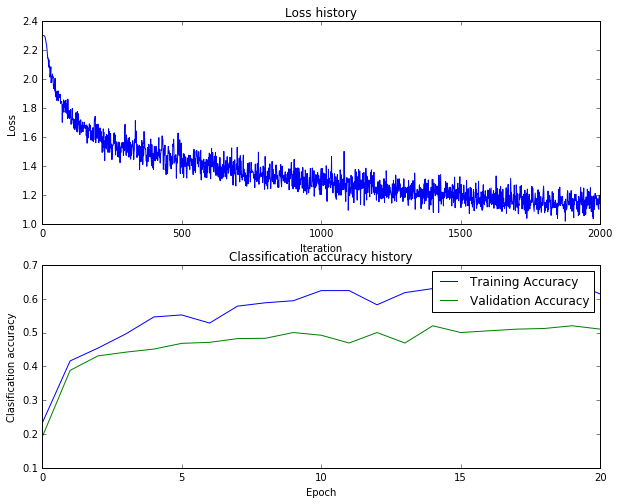

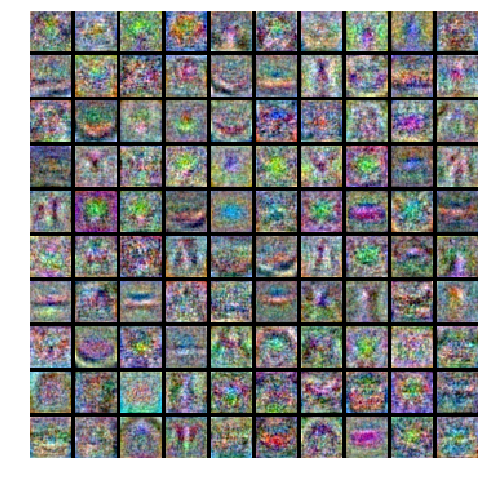

Size = 100, Learning rate = 2.152304e-03, Reg. Strength = 1.647339e-05
iteration 0 / 2000: loss 2.302570
iteration 100 / 2000: loss 1.726667
iteration 200 / 2000: loss 1.566585
iteration 300 / 2000: loss 1.450185
iteration 400 / 2000: loss 1.515786
iteration 500 / 2000: loss 1.473995
iteration 600 / 2000: loss 1.375164
iteration 700 / 2000: loss 1.377060
iteration 800 / 2000: loss 1.301787
iteration 900 / 2000: loss 1.221684
iteration 1000 / 2000: loss 1.228723
iteration 1100 / 2000: loss 1.263805
iteration 1200 / 2000: loss 1.154245
iteration 1300 / 2000: loss 1.222531
iteration 1400 / 2000: loss 1.164170
iteration 1500 / 2000: loss 1.145703
iteration 1600 / 2000: loss 1.153927
iteration 1700 / 2000: loss 1.172077
iteration 1800 / 2000: loss 1.118714
iteration 1900 / 2000: loss 1.111848


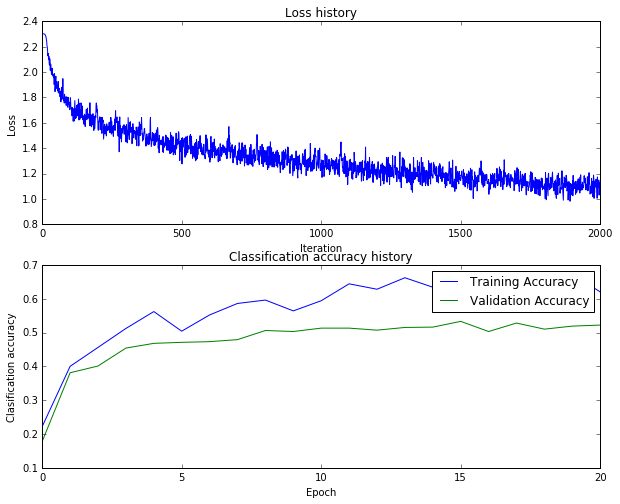

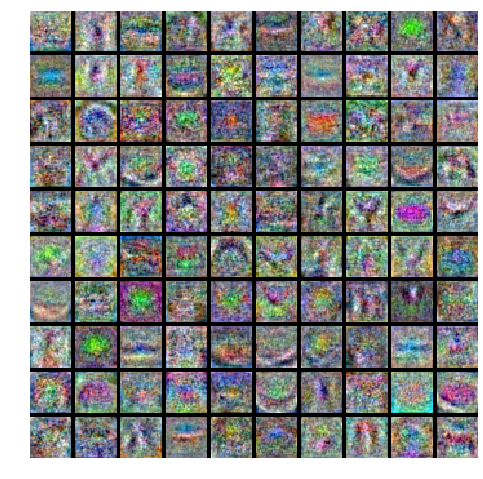

Size = 100, Learning rate = 2.152304e-03, Reg. Strength = 3.642581e-01
iteration 0 / 2000: loss 2.303143
iteration 100 / 2000: loss 1.814993
iteration 200 / 2000: loss 1.577183
iteration 300 / 2000: loss 1.609057
iteration 400 / 2000: loss 1.549674
iteration 500 / 2000: loss 1.341529
iteration 600 / 2000: loss 1.408058
iteration 700 / 2000: loss 1.514201
iteration 800 / 2000: loss 1.385178
iteration 900 / 2000: loss 1.378095
iteration 1000 / 2000: loss 1.364859
iteration 1100 / 2000: loss 1.416155
iteration 1200 / 2000: loss 1.321525
iteration 1300 / 2000: loss 1.462549
iteration 1400 / 2000: loss 1.264512
iteration 1500 / 2000: loss 1.227841
iteration 1600 / 2000: loss 1.290843
iteration 1700 / 2000: loss 1.282558
iteration 1800 / 2000: loss 1.274851
iteration 1900 / 2000: loss 1.355236


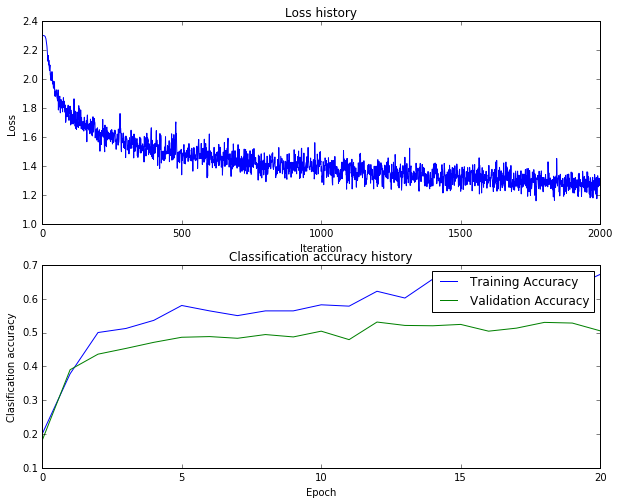

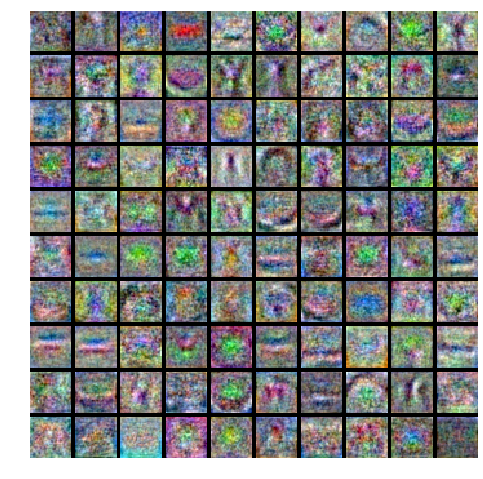

Size = 100, Learning rate = 2.152304e-03, Reg. Strength = 1.327449e-02
iteration 0 / 2000: loss 2.302624
iteration 100 / 2000: loss 1.758370
iteration 200 / 2000: loss 1.619076
iteration 300 / 2000: loss 1.590397
iteration 400 / 2000: loss 1.358145
iteration 500 / 2000: loss 1.424998
iteration 600 / 2000: loss 1.510553
iteration 700 / 2000: loss 1.361292
iteration 800 / 2000: loss 1.322588
iteration 900 / 2000: loss 1.245842
iteration 1000 / 2000: loss 1.312188
iteration 1100 / 2000: loss 1.253436
iteration 1200 / 2000: loss 1.244531
iteration 1300 / 2000: loss 1.242135
iteration 1400 / 2000: loss 1.130373
iteration 1500 / 2000: loss 1.220956
iteration 1600 / 2000: loss 1.156209
iteration 1700 / 2000: loss 1.220797
iteration 1800 / 2000: loss 1.186296
iteration 1900 / 2000: loss 1.223918


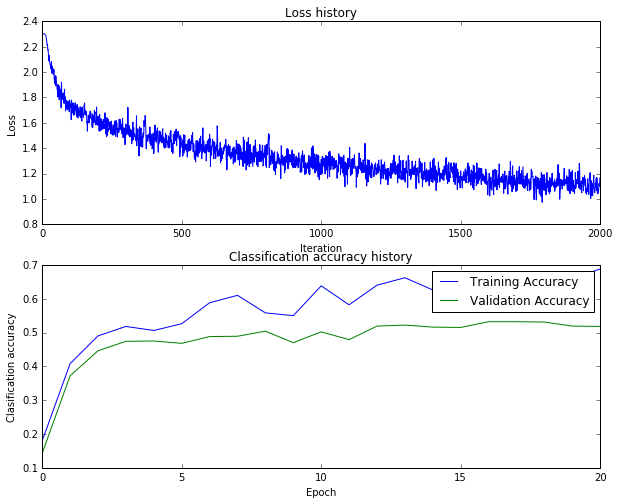

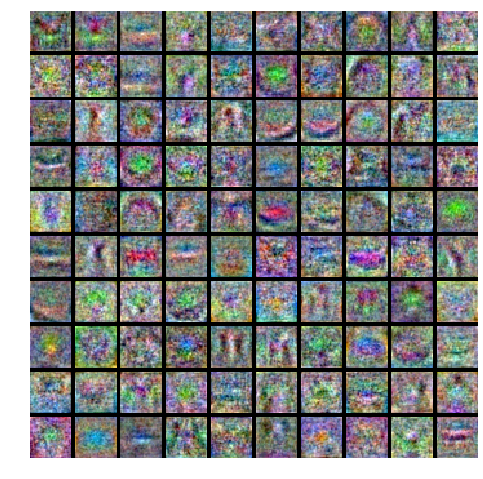

Size = 100, Learning rate = 2.152304e-03, Reg. Strength = 9.568952e-04
iteration 0 / 2000: loss 2.302565
iteration 100 / 2000: loss 1.759962
iteration 200 / 2000: loss 1.660087
iteration 300 / 2000: loss 1.540594
iteration 400 / 2000: loss 1.489797
iteration 500 / 2000: loss 1.430380
iteration 600 / 2000: loss 1.392090
iteration 700 / 2000: loss 1.297649
iteration 800 / 2000: loss 1.342531
iteration 900 / 2000: loss 1.250973
iteration 1000 / 2000: loss 1.325009
iteration 1100 / 2000: loss 1.276046
iteration 1200 / 2000: loss 1.234190
iteration 1300 / 2000: loss 1.160150
iteration 1400 / 2000: loss 1.104005
iteration 1500 / 2000: loss 1.152754
iteration 1600 / 2000: loss 1.085838
iteration 1700 / 2000: loss 1.130639
iteration 1800 / 2000: loss 1.040367
iteration 1900 / 2000: loss 1.100820


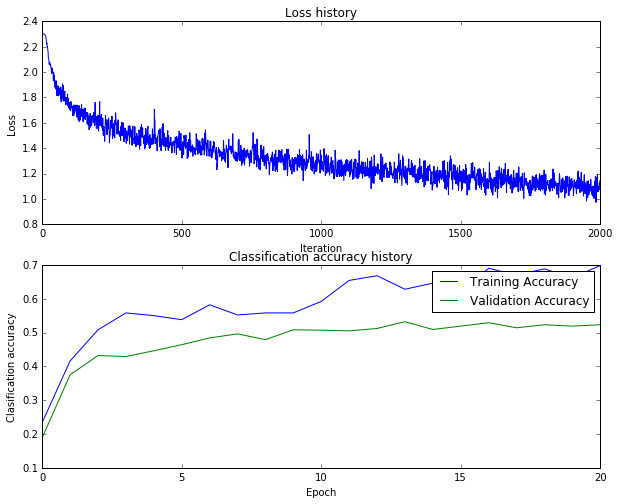

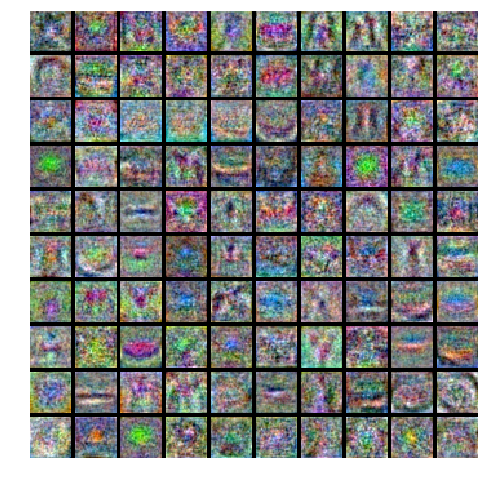

Size = 100, Learning rate = 4.360545e-04, Reg. Strength = 6.163883e-02
iteration 0 / 2000: loss 2.302647
iteration 100 / 2000: loss 2.145559
iteration 200 / 2000: loss 1.967864
iteration 300 / 2000: loss 1.903762
iteration 400 / 2000: loss 1.778629
iteration 500 / 2000: loss 1.772678
iteration 600 / 2000: loss 1.646526
iteration 700 / 2000: loss 1.732122
iteration 800 / 2000: loss 1.550344
iteration 900 / 2000: loss 1.633244
iteration 1000 / 2000: loss 1.510601
iteration 1100 / 2000: loss 1.512511
iteration 1200 / 2000: loss 1.615448
iteration 1300 / 2000: loss 1.557531
iteration 1400 / 2000: loss 1.559565
iteration 1500 / 2000: loss 1.526749
iteration 1600 / 2000: loss 1.472391
iteration 1700 / 2000: loss 1.510631
iteration 1800 / 2000: loss 1.487243
iteration 1900 / 2000: loss 1.475178


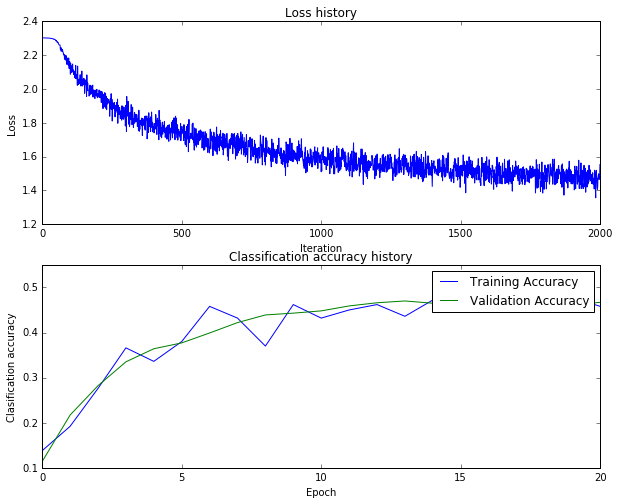

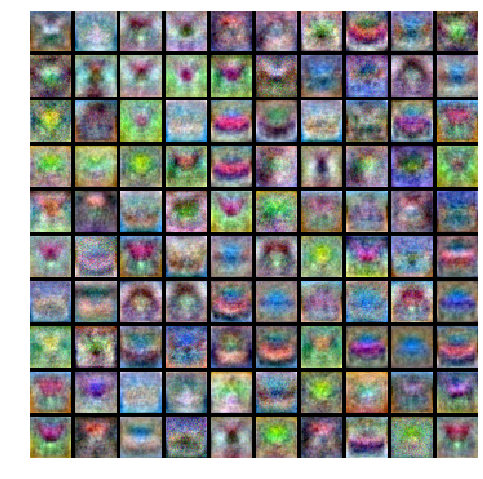

Size = 100, Learning rate = 4.360545e-04, Reg. Strength = 1.647339e-05
iteration 0 / 2000: loss 2.302567
iteration 100 / 2000: loss 2.140505
iteration 200 / 2000: loss 2.007668
iteration 300 / 2000: loss 1.769812
iteration 400 / 2000: loss 1.750651
iteration 500 / 2000: loss 1.759771
iteration 600 / 2000: loss 1.663123
iteration 700 / 2000: loss 1.660830
iteration 800 / 2000: loss 1.654779
iteration 900 / 2000: loss 1.639452
iteration 1000 / 2000: loss 1.554246
iteration 1100 / 2000: loss 1.567105
iteration 1200 / 2000: loss 1.632409
iteration 1300 / 2000: loss 1.606927
iteration 1400 / 2000: loss 1.580243
iteration 1500 / 2000: loss 1.497195
iteration 1600 / 2000: loss 1.507619
iteration 1700 / 2000: loss 1.492607
iteration 1800 / 2000: loss 1.548845
iteration 1900 / 2000: loss 1.519239


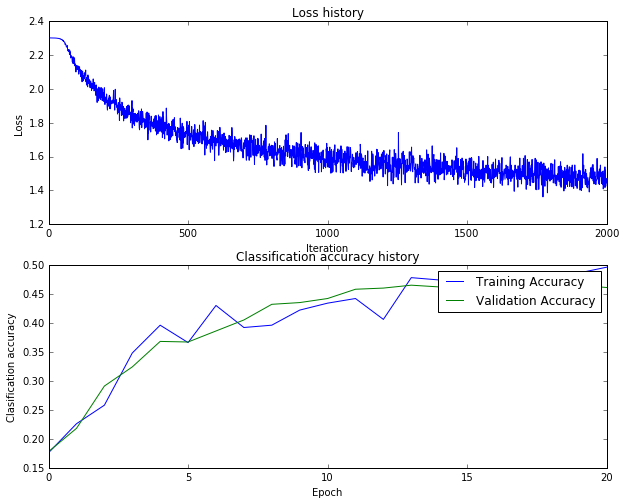

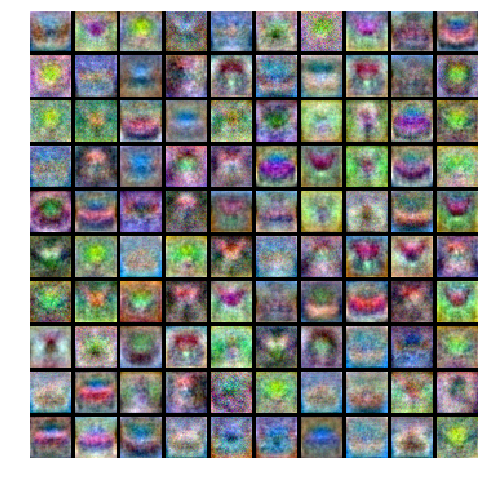

Size = 100, Learning rate = 4.360545e-04, Reg. Strength = 3.642581e-01
iteration 0 / 2000: loss 2.303139
iteration 100 / 2000: loss 2.120422
iteration 200 / 2000: loss 1.960632
iteration 300 / 2000: loss 1.855200
iteration 400 / 2000: loss 1.762202
iteration 500 / 2000: loss 1.782565
iteration 600 / 2000: loss 1.678014
iteration 700 / 2000: loss 1.730454
iteration 800 / 2000: loss 1.693302
iteration 900 / 2000: loss 1.625611
iteration 1000 / 2000: loss 1.629442
iteration 1100 / 2000: loss 1.614595
iteration 1200 / 2000: loss 1.566037
iteration 1300 / 2000: loss 1.543889
iteration 1400 / 2000: loss 1.560762
iteration 1500 / 2000: loss 1.564106
iteration 1600 / 2000: loss 1.578238
iteration 1700 / 2000: loss 1.488651
iteration 1800 / 2000: loss 1.591734
iteration 1900 / 2000: loss 1.553723


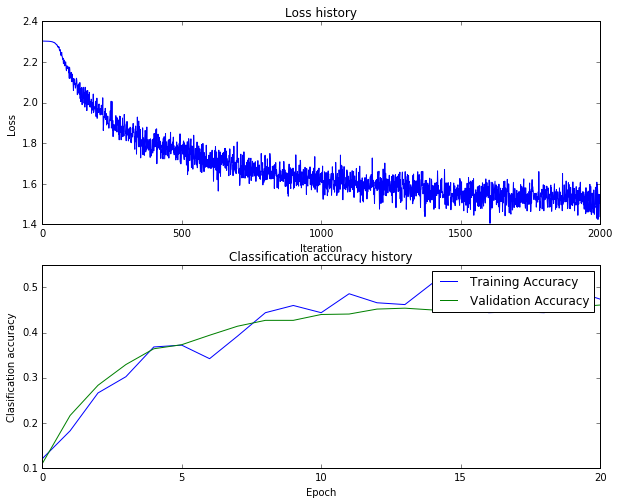

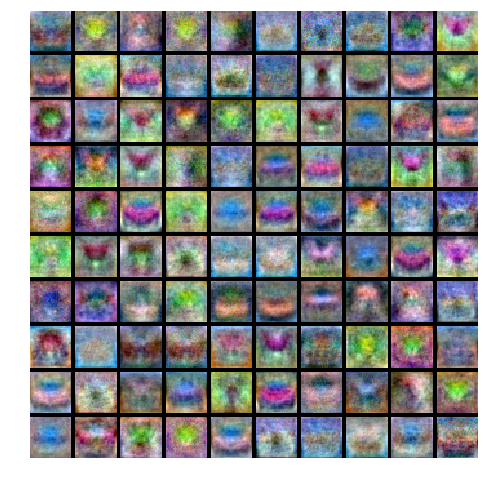

Size = 100, Learning rate = 4.360545e-04, Reg. Strength = 1.327449e-02
iteration 0 / 2000: loss 2.302614
iteration 100 / 2000: loss 2.144878
iteration 200 / 2000: loss 1.970304
iteration 300 / 2000: loss 1.828755
iteration 400 / 2000: loss 1.714594
iteration 500 / 2000: loss 1.684239
iteration 600 / 2000: loss 1.760137
iteration 700 / 2000: loss 1.668631
iteration 800 / 2000: loss 1.598003
iteration 900 / 2000: loss 1.644867
iteration 1000 / 2000: loss 1.576086
iteration 1100 / 2000: loss 1.595411
iteration 1200 / 2000: loss 1.573720
iteration 1300 / 2000: loss 1.538693
iteration 1400 / 2000: loss 1.508700
iteration 1500 / 2000: loss 1.549279
iteration 1600 / 2000: loss 1.516342
iteration 1700 / 2000: loss 1.525101
iteration 1800 / 2000: loss 1.522009
iteration 1900 / 2000: loss 1.515388


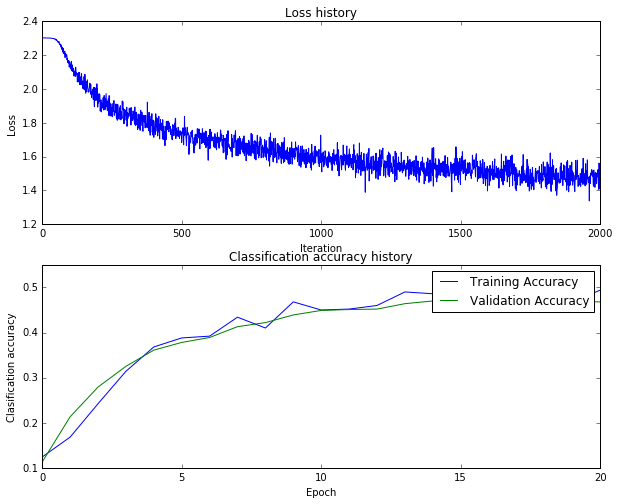

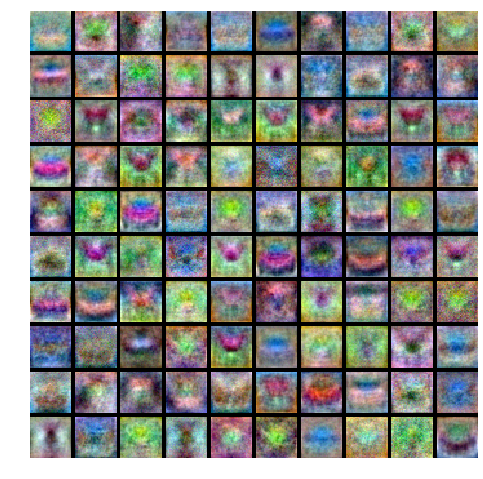

Size = 100, Learning rate = 4.360545e-04, Reg. Strength = 9.568952e-04
iteration 0 / 2000: loss 2.302581
iteration 100 / 2000: loss 2.152763
iteration 200 / 2000: loss 1.928722
iteration 300 / 2000: loss 1.864176
iteration 400 / 2000: loss 1.746710
iteration 500 / 2000: loss 1.700427
iteration 600 / 2000: loss 1.675929
iteration 700 / 2000: loss 1.600347
iteration 800 / 2000: loss 1.648053
iteration 900 / 2000: loss 1.582997
iteration 1000 / 2000: loss 1.581420
iteration 1100 / 2000: loss 1.583752
iteration 1200 / 2000: loss 1.617902
iteration 1300 / 2000: loss 1.521024
iteration 1400 / 2000: loss 1.507826
iteration 1500 / 2000: loss 1.515890
iteration 1600 / 2000: loss 1.421367
iteration 1700 / 2000: loss 1.527384
iteration 1800 / 2000: loss 1.466877
iteration 1900 / 2000: loss 1.410332


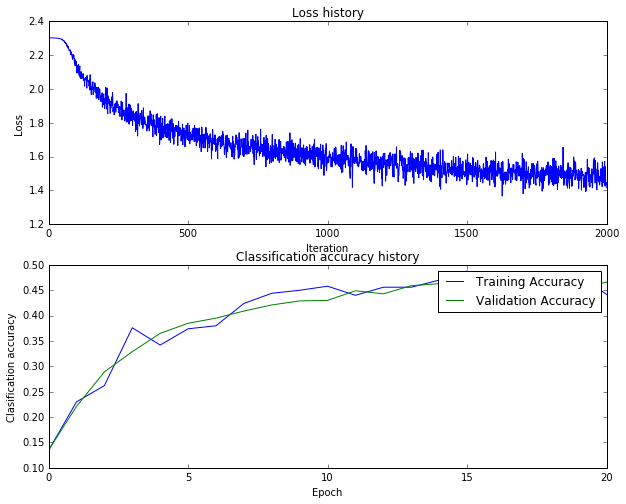

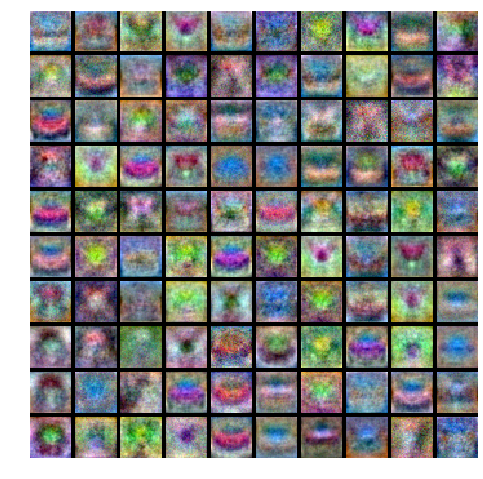

Size = 100, Learning rate = 1.018342e-03, Reg. Strength = 6.163883e-02
iteration 0 / 2000: loss 2.302713
iteration 100 / 2000: loss 1.927583
iteration 200 / 2000: loss 1.764723
iteration 300 / 2000: loss 1.678630
iteration 400 / 2000: loss 1.541746
iteration 500 / 2000: loss 1.542952
iteration 600 / 2000: loss 1.537464
iteration 700 / 2000: loss 1.464062
iteration 800 / 2000: loss 1.479596
iteration 900 / 2000: loss 1.412102
iteration 1000 / 2000: loss 1.371610
iteration 1100 / 2000: loss 1.464466
iteration 1200 / 2000: loss 1.348433
iteration 1300 / 2000: loss 1.352583
iteration 1400 / 2000: loss 1.309368
iteration 1500 / 2000: loss 1.265157
iteration 1600 / 2000: loss 1.315343
iteration 1700 / 2000: loss 1.286466
iteration 1800 / 2000: loss 1.306223
iteration 1900 / 2000: loss 1.212771


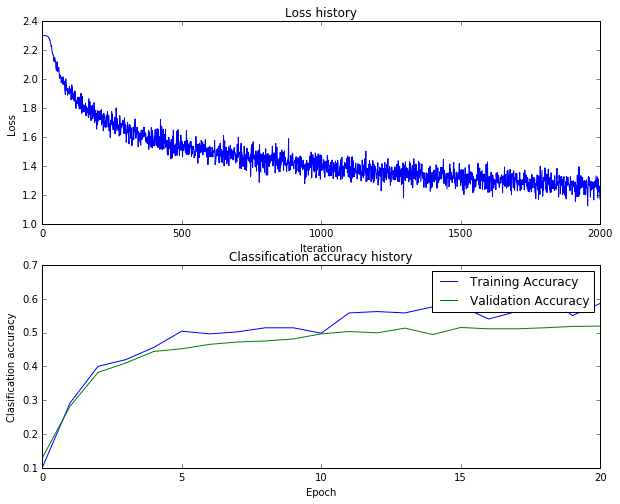

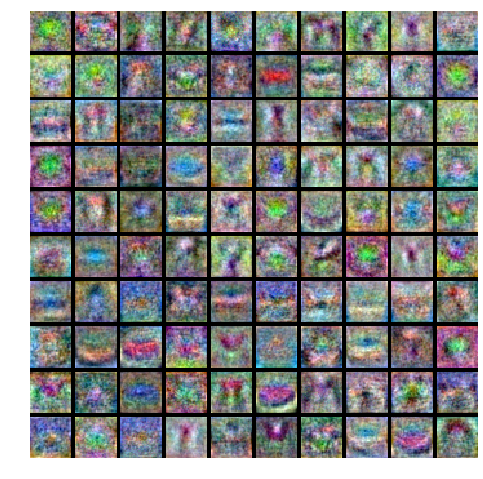

Size = 100, Learning rate = 1.018342e-03, Reg. Strength = 1.647339e-05
iteration 0 / 2000: loss 2.302615
iteration 100 / 2000: loss 1.831296
iteration 200 / 2000: loss 1.802196
iteration 300 / 2000: loss 1.677334
iteration 400 / 2000: loss 1.663104
iteration 500 / 2000: loss 1.514795
iteration 600 / 2000: loss 1.521954
iteration 700 / 2000: loss 1.488672
iteration 800 / 2000: loss 1.385373
iteration 900 / 2000: loss 1.404701
iteration 1000 / 2000: loss 1.344395
iteration 1100 / 2000: loss 1.368279
iteration 1200 / 2000: loss 1.348267
iteration 1300 / 2000: loss 1.281554
iteration 1400 / 2000: loss 1.267943
iteration 1500 / 2000: loss 1.288538
iteration 1600 / 2000: loss 1.298098
iteration 1700 / 2000: loss 1.215848
iteration 1800 / 2000: loss 1.346186
iteration 1900 / 2000: loss 1.185342


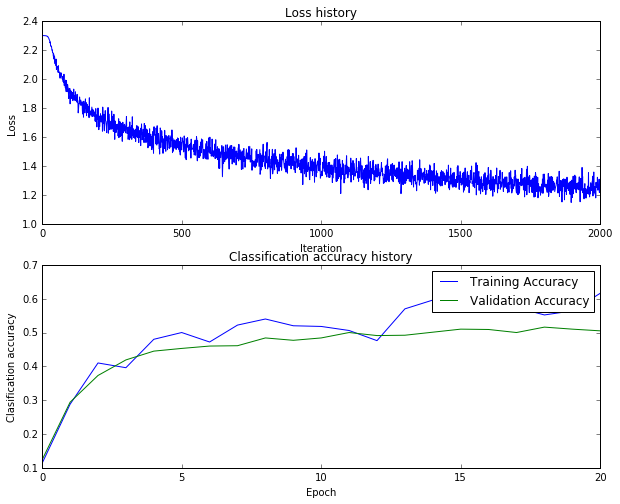

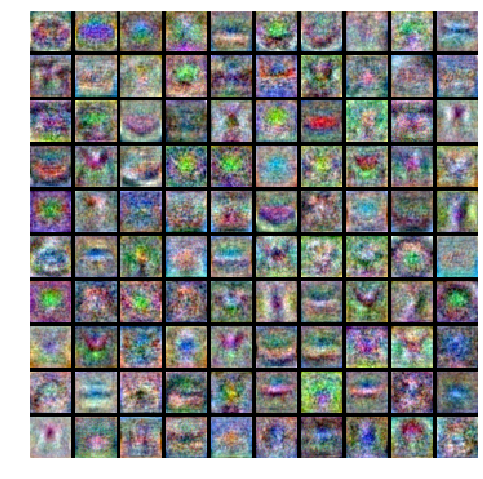

Size = 100, Learning rate = 1.018342e-03, Reg. Strength = 3.642581e-01
iteration 0 / 2000: loss 2.303120
iteration 100 / 2000: loss 1.930936
iteration 200 / 2000: loss 1.756844
iteration 300 / 2000: loss 1.716795
iteration 400 / 2000: loss 1.582660
iteration 500 / 2000: loss 1.552845
iteration 600 / 2000: loss 1.466479
iteration 700 / 2000: loss 1.560968
iteration 800 / 2000: loss 1.476251
iteration 900 / 2000: loss 1.467910
iteration 1000 / 2000: loss 1.482776
iteration 1100 / 2000: loss 1.477786
iteration 1200 / 2000: loss 1.382111
iteration 1300 / 2000: loss 1.430653
iteration 1400 / 2000: loss 1.418954
iteration 1500 / 2000: loss 1.389127
iteration 1600 / 2000: loss 1.483145
iteration 1700 / 2000: loss 1.461161
iteration 1800 / 2000: loss 1.392172
iteration 1900 / 2000: loss 1.326580


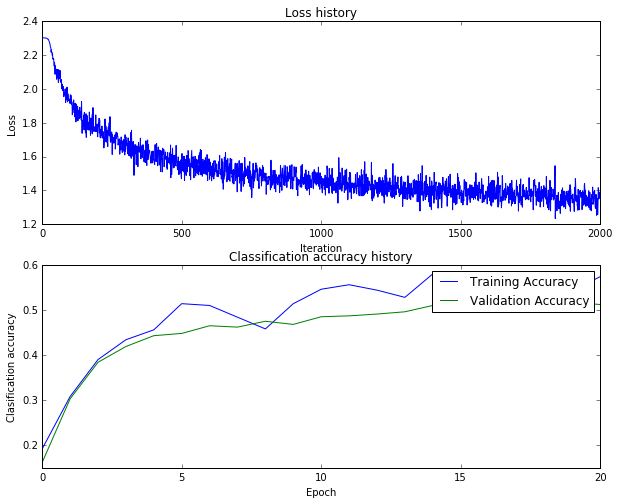

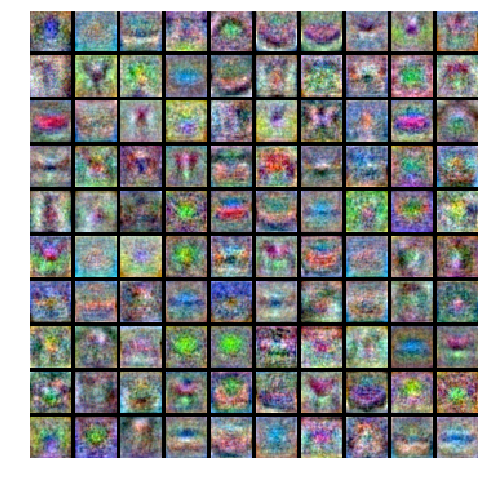

Size = 100, Learning rate = 1.018342e-03, Reg. Strength = 1.327449e-02
iteration 0 / 2000: loss 2.302563
iteration 100 / 2000: loss 1.960655
iteration 200 / 2000: loss 1.767380
iteration 300 / 2000: loss 1.620554
iteration 400 / 2000: loss 1.597621
iteration 500 / 2000: loss 1.559073
iteration 600 / 2000: loss 1.489792
iteration 700 / 2000: loss 1.425149
iteration 800 / 2000: loss 1.369718
iteration 900 / 2000: loss 1.487093
iteration 1000 / 2000: loss 1.422726
iteration 1100 / 2000: loss 1.387425
iteration 1200 / 2000: loss 1.383749
iteration 1300 / 2000: loss 1.343874
iteration 1400 / 2000: loss 1.308024
iteration 1500 / 2000: loss 1.207624
iteration 1600 / 2000: loss 1.340651
iteration 1700 / 2000: loss 1.275921
iteration 1800 / 2000: loss 1.317558
iteration 1900 / 2000: loss 1.207116


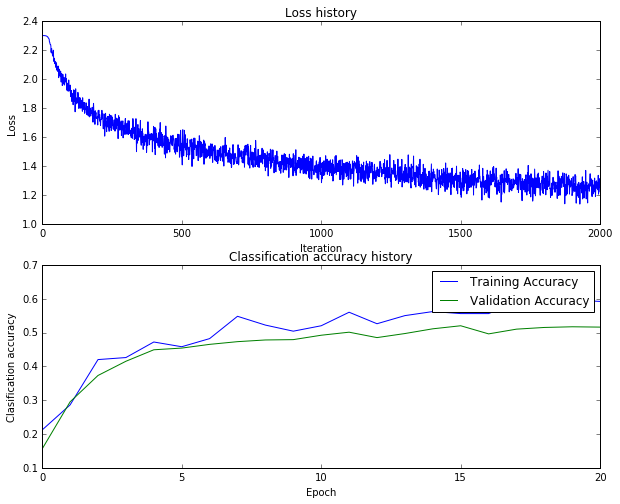

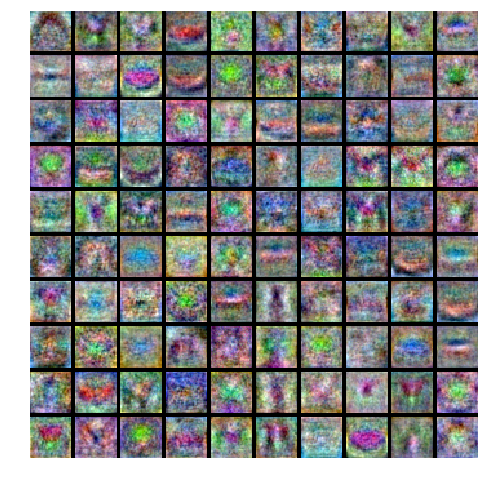

Size = 100, Learning rate = 1.018342e-03, Reg. Strength = 9.568952e-04
iteration 0 / 2000: loss 2.302599
iteration 100 / 2000: loss 1.971551
iteration 200 / 2000: loss 1.766928
iteration 300 / 2000: loss 1.656657
iteration 400 / 2000: loss 1.568664
iteration 500 / 2000: loss 1.459945
iteration 600 / 2000: loss 1.531552
iteration 700 / 2000: loss 1.470139
iteration 800 / 2000: loss 1.420509
iteration 900 / 2000: loss 1.396352
iteration 1000 / 2000: loss 1.340064
iteration 1100 / 2000: loss 1.438359
iteration 1200 / 2000: loss 1.456321
iteration 1300 / 2000: loss 1.316605
iteration 1400 / 2000: loss 1.257653
iteration 1500 / 2000: loss 1.362748
iteration 1600 / 2000: loss 1.217972
iteration 1700 / 2000: loss 1.299403
iteration 1800 / 2000: loss 1.216583
iteration 1900 / 2000: loss 1.221410


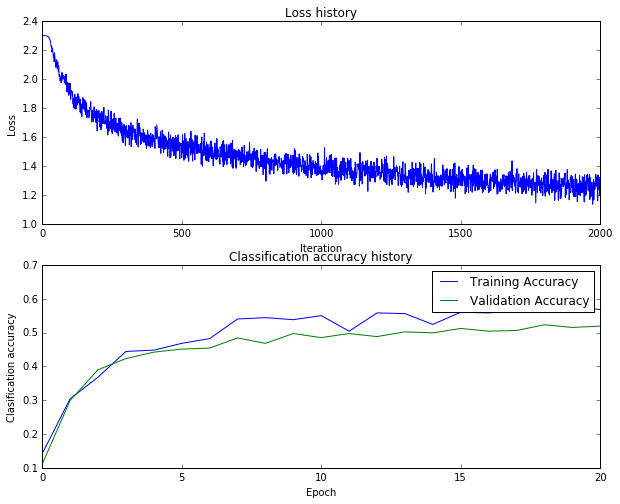

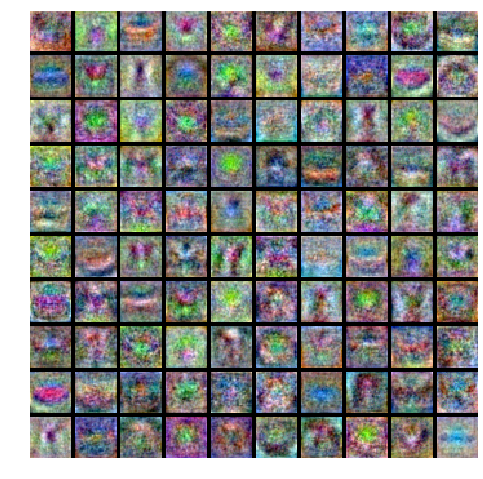

Size = 100, Learning rate = 6.729694e-04, Reg. Strength = 6.163883e-02
iteration 0 / 2000: loss 2.302708
iteration 100 / 2000: loss 2.020684
iteration 200 / 2000: loss 1.839609
iteration 300 / 2000: loss 1.770120
iteration 400 / 2000: loss 1.681035
iteration 500 / 2000: loss 1.665207
iteration 600 / 2000: loss 1.545194
iteration 700 / 2000: loss 1.528083
iteration 800 / 2000: loss 1.612302
iteration 900 / 2000: loss 1.470177
iteration 1000 / 2000: loss 1.478445
iteration 1100 / 2000: loss 1.417924
iteration 1200 / 2000: loss 1.474584
iteration 1300 / 2000: loss 1.451236
iteration 1400 / 2000: loss 1.556705
iteration 1500 / 2000: loss 1.370398
iteration 1600 / 2000: loss 1.459094
iteration 1700 / 2000: loss 1.454389
iteration 1800 / 2000: loss 1.397069
iteration 1900 / 2000: loss 1.444051


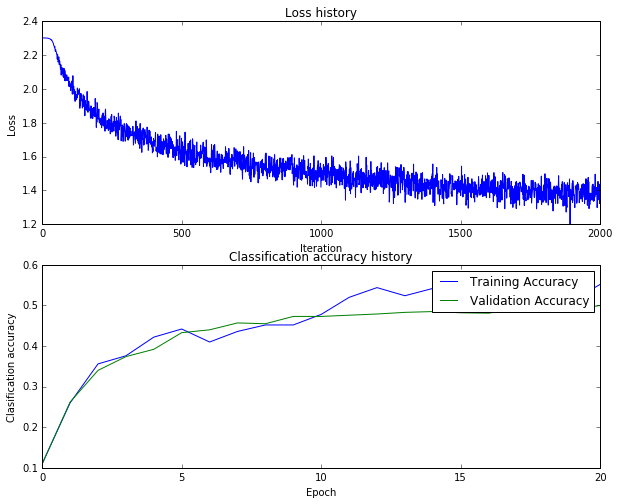

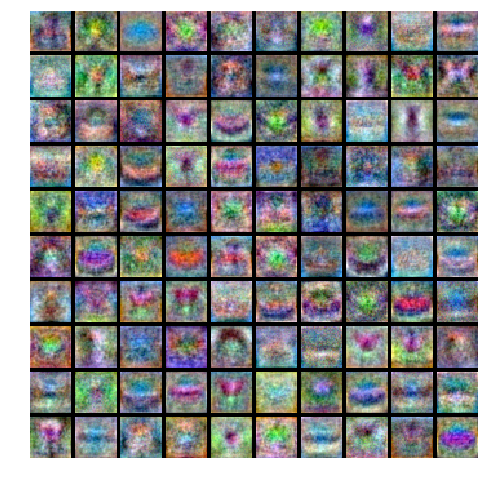

Size = 100, Learning rate = 6.729694e-04, Reg. Strength = 1.647339e-05
iteration 0 / 2000: loss 2.302590
iteration 100 / 2000: loss 2.024951
iteration 200 / 2000: loss 1.760707
iteration 300 / 2000: loss 1.672186
iteration 400 / 2000: loss 1.707966
iteration 500 / 2000: loss 1.681731
iteration 600 / 2000: loss 1.634141
iteration 700 / 2000: loss 1.615610
iteration 800 / 2000: loss 1.511772
iteration 900 / 2000: loss 1.506216
iteration 1000 / 2000: loss 1.571334
iteration 1100 / 2000: loss 1.481532
iteration 1200 / 2000: loss 1.421400
iteration 1300 / 2000: loss 1.383308
iteration 1400 / 2000: loss 1.436566
iteration 1500 / 2000: loss 1.433730
iteration 1600 / 2000: loss 1.361042
iteration 1700 / 2000: loss 1.377425
iteration 1800 / 2000: loss 1.360033
iteration 1900 / 2000: loss 1.354707


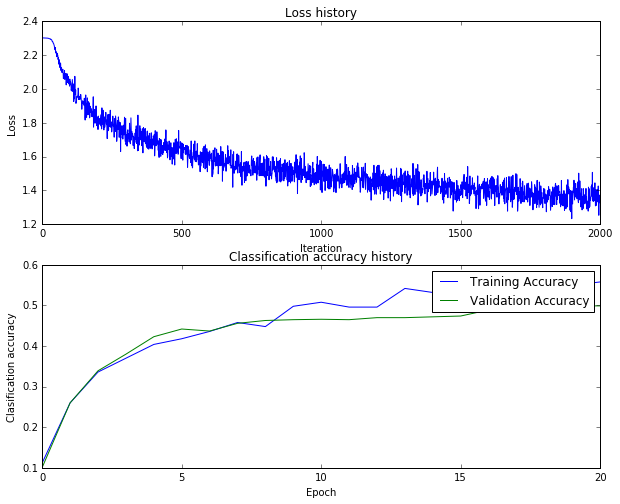

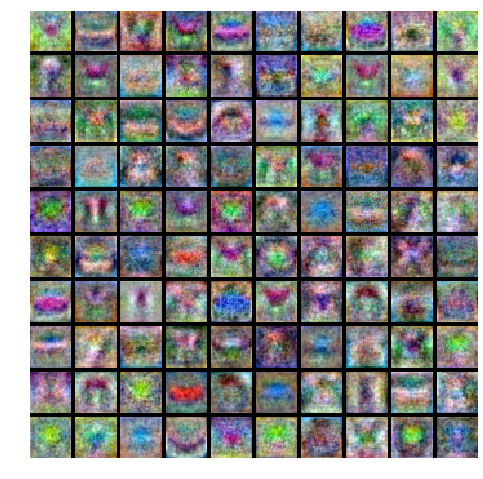

Size = 100, Learning rate = 6.729694e-04, Reg. Strength = 3.642581e-01
iteration 0 / 2000: loss 2.303112
iteration 100 / 2000: loss 1.995424
iteration 200 / 2000: loss 1.866322
iteration 300 / 2000: loss 1.761980
iteration 400 / 2000: loss 1.681399
iteration 500 / 2000: loss 1.675150
iteration 600 / 2000: loss 1.600023
iteration 700 / 2000: loss 1.580249
iteration 800 / 2000: loss 1.526752
iteration 900 / 2000: loss 1.585759
iteration 1000 / 2000: loss 1.567062
iteration 1100 / 2000: loss 1.493083
iteration 1200 / 2000: loss 1.487036
iteration 1300 / 2000: loss 1.458279
iteration 1400 / 2000: loss 1.532020
iteration 1500 / 2000: loss 1.444572
iteration 1600 / 2000: loss 1.475391
iteration 1700 / 2000: loss 1.464610
iteration 1800 / 2000: loss 1.410619
iteration 1900 / 2000: loss 1.493704


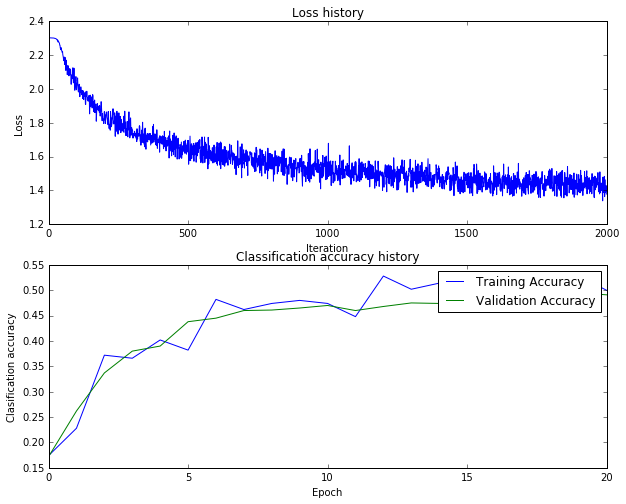

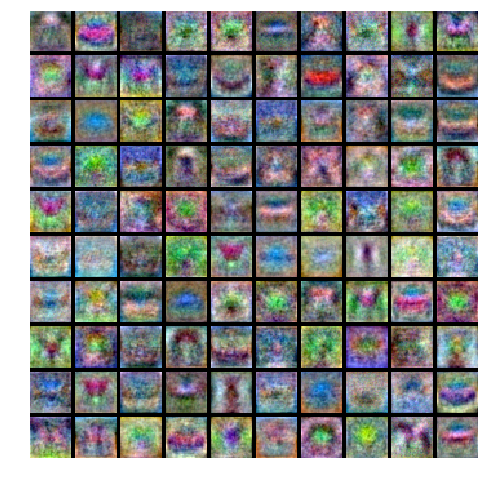

Size = 100, Learning rate = 6.729694e-04, Reg. Strength = 1.327449e-02
iteration 0 / 2000: loss 2.302601
iteration 100 / 2000: loss 2.012099
iteration 200 / 2000: loss 1.810178
iteration 300 / 2000: loss 1.774615
iteration 400 / 2000: loss 1.704835
iteration 500 / 2000: loss 1.633312
iteration 600 / 2000: loss 1.540757
iteration 700 / 2000: loss 1.616513
iteration 800 / 2000: loss 1.466708
iteration 900 / 2000: loss 1.520370
iteration 1000 / 2000: loss 1.476683
iteration 1100 / 2000: loss 1.460071
iteration 1200 / 2000: loss 1.442272
iteration 1300 / 2000: loss 1.462571
iteration 1400 / 2000: loss 1.390613
iteration 1500 / 2000: loss 1.459336
iteration 1600 / 2000: loss 1.356637
iteration 1700 / 2000: loss 1.343242
iteration 1800 / 2000: loss 1.360697
iteration 1900 / 2000: loss 1.377170


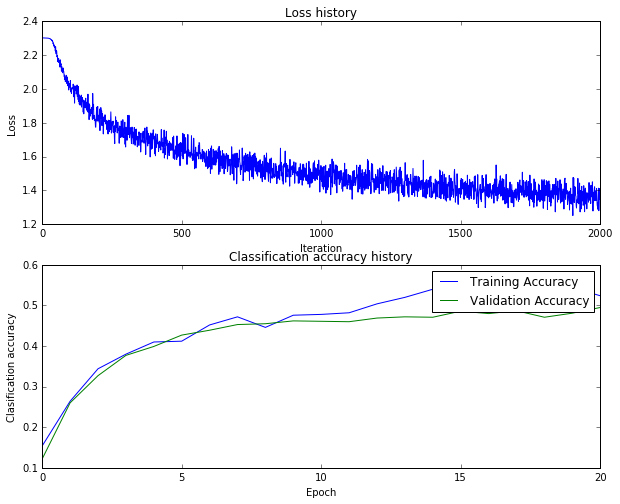

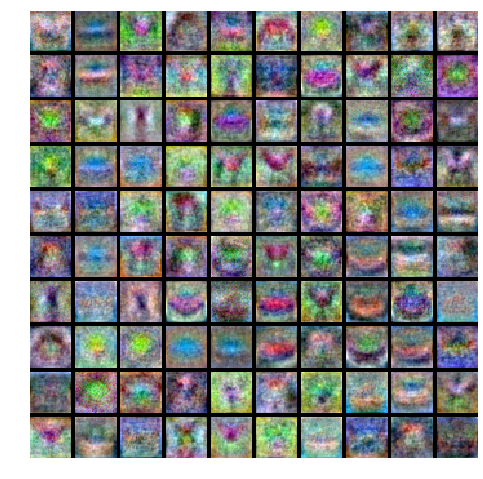

Size = 100, Learning rate = 6.729694e-04, Reg. Strength = 9.568952e-04
iteration 0 / 2000: loss 2.302567
iteration 100 / 2000: loss 2.071029
iteration 200 / 2000: loss 1.811152
iteration 300 / 2000: loss 1.774006
iteration 400 / 2000: loss 1.701853
iteration 500 / 2000: loss 1.623525
iteration 600 / 2000: loss 1.657581
iteration 700 / 2000: loss 1.604245
iteration 800 / 2000: loss 1.496749
iteration 900 / 2000: loss 1.513629
iteration 1000 / 2000: loss 1.555522
iteration 1100 / 2000: loss 1.497826
iteration 1200 / 2000: loss 1.439541
iteration 1300 / 2000: loss 1.441556
iteration 1400 / 2000: loss 1.505308
iteration 1500 / 2000: loss 1.344955
iteration 1600 / 2000: loss 1.424771
iteration 1700 / 2000: loss 1.373505
iteration 1800 / 2000: loss 1.319997
iteration 1900 / 2000: loss 1.444625


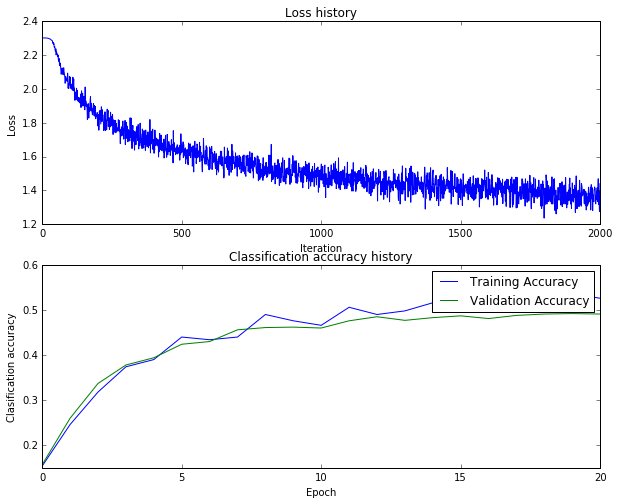

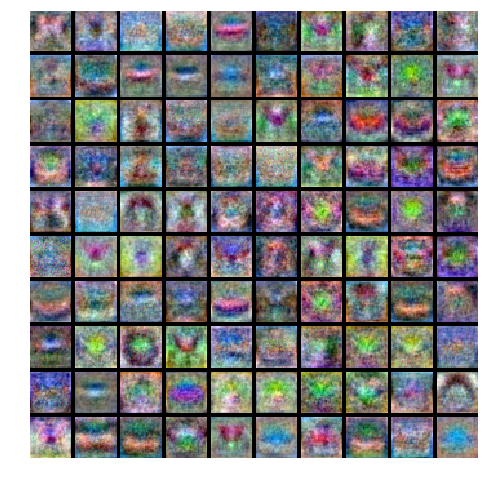

Size = 100, Learning rate = 8.851225e-04, Reg. Strength = 6.163883e-02
iteration 0 / 2000: loss 2.302669
iteration 100 / 2000: loss 1.996117
iteration 200 / 2000: loss 1.735871
iteration 300 / 2000: loss 1.661921
iteration 400 / 2000: loss 1.644209
iteration 500 / 2000: loss 1.542777
iteration 600 / 2000: loss 1.574194
iteration 700 / 2000: loss 1.521494
iteration 800 / 2000: loss 1.468653
iteration 900 / 2000: loss 1.426761
iteration 1000 / 2000: loss 1.397685
iteration 1100 / 2000: loss 1.390785
iteration 1200 / 2000: loss 1.375681
iteration 1300 / 2000: loss 1.385417
iteration 1400 / 2000: loss 1.445403
iteration 1500 / 2000: loss 1.330956
iteration 1600 / 2000: loss 1.340443
iteration 1700 / 2000: loss 1.327885
iteration 1800 / 2000: loss 1.337664
iteration 1900 / 2000: loss 1.262061


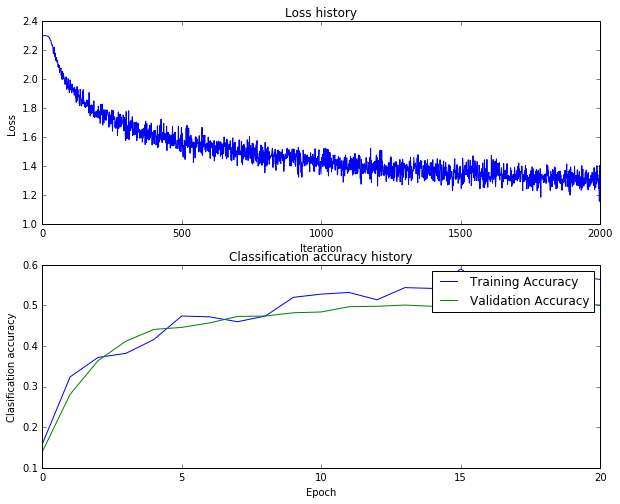

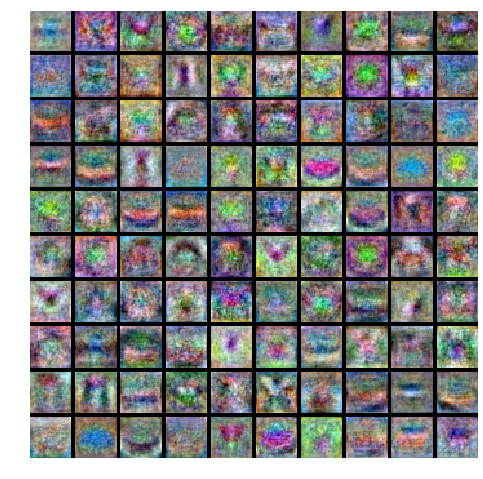

Size = 100, Learning rate = 8.851225e-04, Reg. Strength = 1.647339e-05
iteration 0 / 2000: loss 2.302575
iteration 100 / 2000: loss 1.950384
iteration 200 / 2000: loss 1.790888
iteration 300 / 2000: loss 1.675573
iteration 400 / 2000: loss 1.604657
iteration 500 / 2000: loss 1.669343
iteration 600 / 2000: loss 1.518783
iteration 700 / 2000: loss 1.455439
iteration 800 / 2000: loss 1.463560
iteration 900 / 2000: loss 1.424565
iteration 1000 / 2000: loss 1.405249
iteration 1100 / 2000: loss 1.432127
iteration 1200 / 2000: loss 1.429910
iteration 1300 / 2000: loss 1.490778
iteration 1400 / 2000: loss 1.412468
iteration 1500 / 2000: loss 1.334473
iteration 1600 / 2000: loss 1.375886
iteration 1700 / 2000: loss 1.271993
iteration 1800 / 2000: loss 1.317323
iteration 1900 / 2000: loss 1.241695


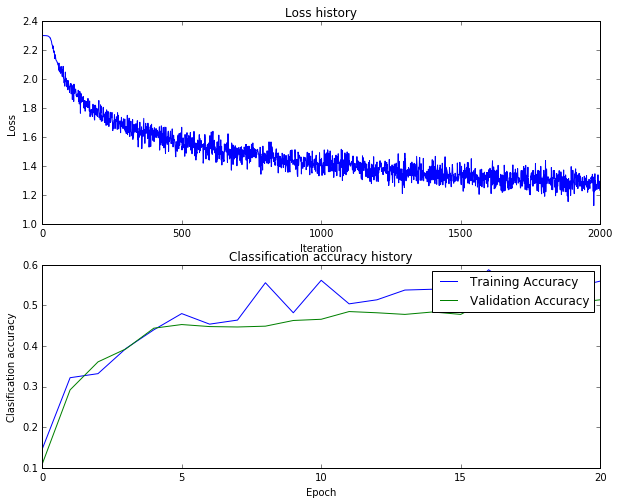

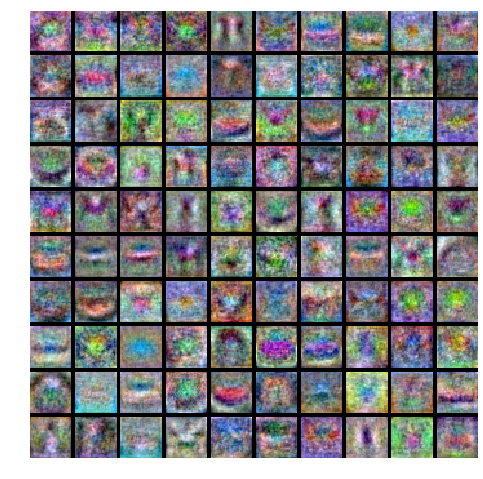

Size = 100, Learning rate = 8.851225e-04, Reg. Strength = 3.642581e-01
iteration 0 / 2000: loss 2.303161
iteration 100 / 2000: loss 1.954183
iteration 200 / 2000: loss 1.777439
iteration 300 / 2000: loss 1.747440
iteration 400 / 2000: loss 1.688773
iteration 500 / 2000: loss 1.608578
iteration 600 / 2000: loss 1.520598
iteration 700 / 2000: loss 1.539724
iteration 800 / 2000: loss 1.546177
iteration 900 / 2000: loss 1.508077
iteration 1000 / 2000: loss 1.392506
iteration 1100 / 2000: loss 1.502648
iteration 1200 / 2000: loss 1.423818
iteration 1300 / 2000: loss 1.470300
iteration 1400 / 2000: loss 1.395437
iteration 1500 / 2000: loss 1.457555
iteration 1600 / 2000: loss 1.445076
iteration 1700 / 2000: loss 1.357949
iteration 1800 / 2000: loss 1.315279
iteration 1900 / 2000: loss 1.442518


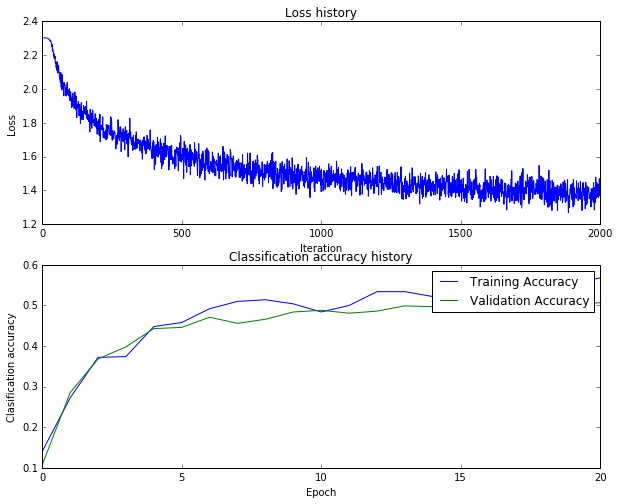

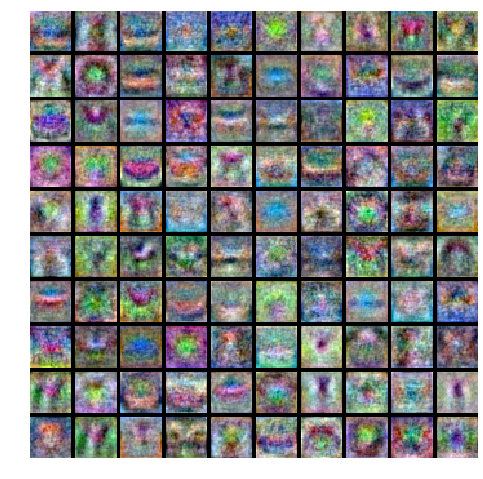

Size = 100, Learning rate = 8.851225e-04, Reg. Strength = 1.327449e-02
iteration 0 / 2000: loss 2.302638
iteration 100 / 2000: loss 1.944832
iteration 200 / 2000: loss 1.760495
iteration 300 / 2000: loss 1.626748
iteration 400 / 2000: loss 1.722633
iteration 500 / 2000: loss 1.628190
iteration 600 / 2000: loss 1.487240
iteration 700 / 2000: loss 1.502515
iteration 800 / 2000: loss 1.478755
iteration 900 / 2000: loss 1.517074
iteration 1000 / 2000: loss 1.373241
iteration 1100 / 2000: loss 1.389347
iteration 1200 / 2000: loss 1.465679
iteration 1300 / 2000: loss 1.472621
iteration 1400 / 2000: loss 1.340524
iteration 1500 / 2000: loss 1.241645
iteration 1600 / 2000: loss 1.323630
iteration 1700 / 2000: loss 1.267822
iteration 1800 / 2000: loss 1.333092
iteration 1900 / 2000: loss 1.321108


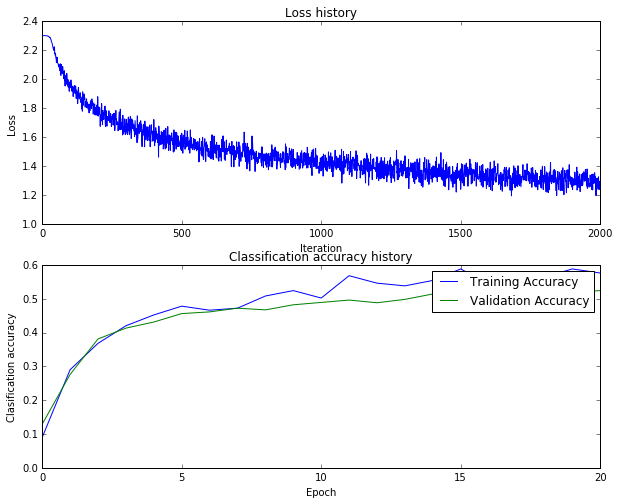

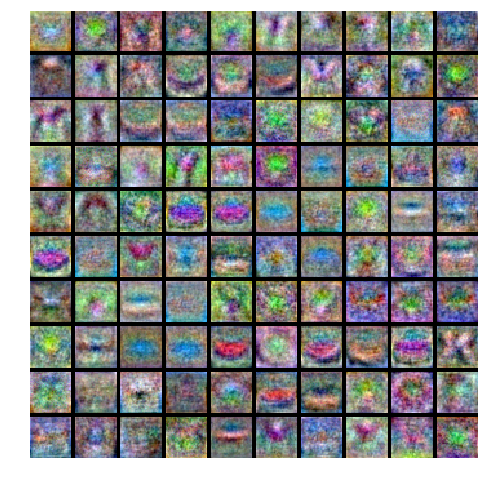

Size = 100, Learning rate = 8.851225e-04, Reg. Strength = 9.568952e-04
iteration 0 / 2000: loss 2.302583
iteration 100 / 2000: loss 1.970628
iteration 200 / 2000: loss 1.812644
iteration 300 / 2000: loss 1.646894
iteration 400 / 2000: loss 1.650191
iteration 500 / 2000: loss 1.521128
iteration 600 / 2000: loss 1.603896
iteration 700 / 2000: loss 1.510951
iteration 800 / 2000: loss 1.497514
iteration 900 / 2000: loss 1.374568
iteration 1000 / 2000: loss 1.451001
iteration 1100 / 2000: loss 1.417468
iteration 1200 / 2000: loss 1.262071
iteration 1300 / 2000: loss 1.447610
iteration 1400 / 2000: loss 1.386221
iteration 1500 / 2000: loss 1.383419
iteration 1600 / 2000: loss 1.399191
iteration 1700 / 2000: loss 1.337925
iteration 1800 / 2000: loss 1.326438
iteration 1900 / 2000: loss 1.336542


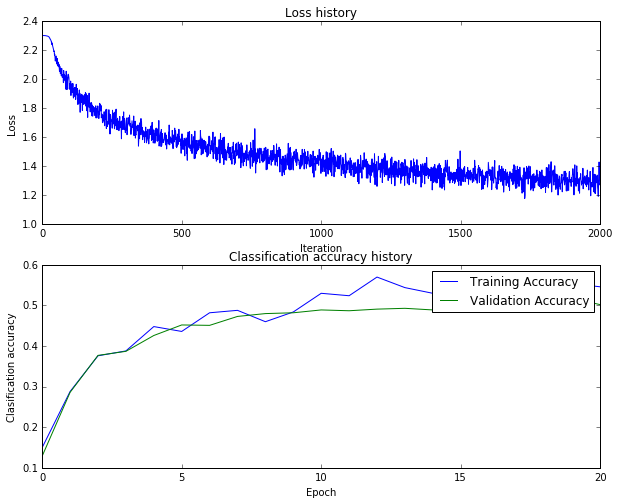

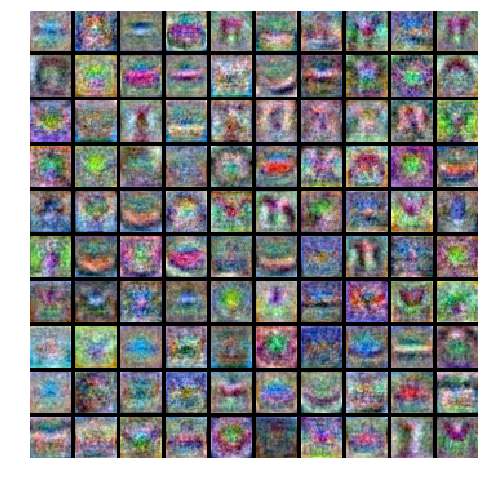

size 100 lr 4.360545e-04 reg 1.647339e-05 train accuracy: 0.485898 val accuracy: 0.471000
size 100 lr 4.360545e-04 reg 9.568952e-04 train accuracy: 0.485061 val accuracy: 0.471000
size 100 lr 4.360545e-04 reg 1.327449e-02 train accuracy: 0.484286 val accuracy: 0.464000
size 100 lr 4.360545e-04 reg 6.163883e-02 train accuracy: 0.486980 val accuracy: 0.477000
size 100 lr 4.360545e-04 reg 3.642581e-01 train accuracy: 0.479061 val accuracy: 0.458000
size 100 lr 6.729694e-04 reg 1.647339e-05 train accuracy: 0.528367 val accuracy: 0.503000
size 100 lr 6.729694e-04 reg 9.568952e-04 train accuracy: 0.526224 val accuracy: 0.496000
size 100 lr 6.729694e-04 reg 1.327449e-02 train accuracy: 0.527204 val accuracy: 0.491000
size 100 lr 6.729694e-04 reg 6.163883e-02 train accuracy: 0.524918 val accuracy: 0.498000
size 100 lr 6.729694e-04 reg 3.642581e-01 train accuracy: 0.524878 val accuracy: 0.482000
size 100 lr 8.851225e-04 reg 1.647339e-05 train accuracy: 0.554592 val accuracy: 0.505000
size 100 l

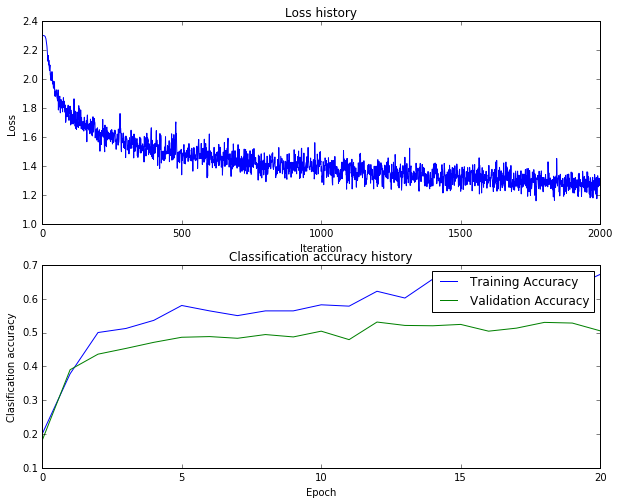

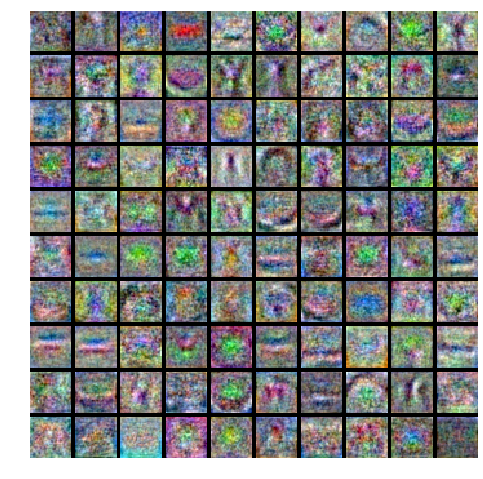

In [47]:
# best_net = None # store the best model into this 

#################################################################################
# TODO: Tune hyperparameters using the validation set. Store your best trained  #
# model in best_net.                                                            #
#                                                                               #
# To help debug your network, it may help to use visualizations similar to the  #
# ones we used above; these visualizations will have significant qualitative    #
# differences from the ones we saw above for the poorly tuned network.          #
#                                                                               #
# Tweaking hyperparameters by hand can be fun, but you might find it useful to  #
# write code to sweep through possible combinations of hyperparameters          #
# automatically like we did on the previous exercises.                          #
#################################################################################

stats = {}
results = {}
best_val = -1
best_stats = None

input_size = 32 * 32 * 3
num_classes = 10

# hidden_sizes = (100 * np.random.rand(5)).round().astype(int)
# learning_rates = (5e-3 - 5e-5) * np.random.rand(5) + 5e-5
# regularization_strengths = np.random.rand(5)

# hidden_sizes = [50, 75, 100]
# learning_rates = [5e-4]
# regularization_strengths = [0.65, 0.75, 0.85]

# hidden_sizes = np.round(10 ** np.random.uniform(1.7,2.3,3)).astype(int)
hidden_sizes = [100]
learning_rates = 10 ** np.random.uniform(-3.5,-2.5,5)
regularization_strengths = 10 ** np.random.uniform(-5,1,5)

for hidden_size in hidden_sizes:
    
    for learning_rate in learning_rates:

        for regularization_strength in regularization_strengths:
            
            # Print hyperparameters
            print 'Size = %d, Learning rate = %e, Reg. Strength = %e' % (
                hidden_size, learning_rate, regularization_strength)

            # Initialize net
            net = TwoLayerNet(input_size, hidden_size, num_classes)

            # Training
            stats[hidden_size, learning_rate, regularization_strength] = \
                net.train(X_train, y_train, X_val, y_val,
                          num_iters=2000, batch_size=500,
                          learning_rate=learning_rate, learning_rate_decay=0.95,
                          reg=regularization_strength, verbose=True)

            # Testing
            y_train_pred = net.predict(X_train)
            y_val_pred = net.predict(X_val)

            # Evaluation
            train_num_correct = np.sum(y_train_pred == y_train)
            training_accuracy = float(train_num_correct) / X_train.shape[0]

            val_num_correct = np.sum(y_val_pred == y_val)
            validation_accuracy = float(val_num_correct) / X_val.shape[0]

            results[hidden_size, learning_rate, regularization_strength] = training_accuracy, validation_accuracy

            if validation_accuracy > best_val:
                best_val = validation_accuracy
                best_net = net
                best_stats = stats[hidden_size, learning_rate, regularization_strength]
                
            current_stats = stats[hidden_size, learning_rate, regularization_strength]
                
            # Plot the loss function and train / validation accuracies
            plt.subplot(2, 1, 1)
            plt.plot(current_stats['loss_history'])
            plt.title('Loss history')
            plt.xlabel('Iteration')
            plt.ylabel('Loss')

            plt.subplot(2, 1, 2)
            train_acc, = plt.plot(current_stats['train_acc_history'], label='train')
            val_acc, = plt.plot(current_stats['val_acc_history'], label='val')
            plt.legend([train_acc, val_acc], ['Training Accuracy', 'Validation Accuracy'])
            plt.title('Classification accuracy history')
            plt.xlabel('Epoch')
            plt.ylabel('Clasification accuracy')
            plt.show()
            
            # visualize the weights of the current network
            show_net_weights(net)

pass

# Print out results.
for hid_size, lr, reg in sorted(results):
    train_accuracy, val_accuracy = results[(hid_size, lr, reg)]
    print 'size %d lr %e reg %e train accuracy: %f val accuracy: %f' % (
                hid_size, lr, reg, train_accuracy, val_accuracy)
    
print 'best validation accuracy achieved during cross-validation: %f' % best_val

# Plot the loss function and train / validation accuracies
plt.subplot(2, 1, 1)
plt.plot(best_stats['loss_history'])
plt.title('Loss history')
plt.xlabel('Iteration')
plt.ylabel('Loss')

plt.subplot(2, 1, 2)
train_acc, = plt.plot(best_stats['train_acc_history'], label='train')
val_acc, = plt.plot(best_stats['val_acc_history'], label='val')
plt.legend([train_acc, val_acc], ['Training Accuracy', 'Validation Accuracy'])
plt.title('Classification accuracy history')
plt.xlabel('Epoch')
plt.ylabel('Clasification accuracy')
plt.show()

# visualize the weights of the current network
show_net_weights(best_net)

pass
#################################################################################
#                               END OF YOUR CODE                                #
#################################################################################

In [ ]:
# Plot the loss function and train / validation accuracies
plt.subplot(2, 1, 1)
plt.plot(best_stats['loss_history'])
plt.title('Loss history')
plt.xlabel('Iteration')
plt.ylabel('Loss')

plt.subplot(2, 1, 2)
train_acc, = plt.plot(best_stats['train_acc_history'], label='train')
val_acc, = plt.plot(best_stats['val_acc_history'], label='val')
plt.legend([train_acc, val_acc], ['Training Accuracy', 'Validation Accuracy'])
plt.title('Classification accuracy history')
plt.xlabel('Epoch')
plt.ylabel('Clasification accuracy')
plt.show()

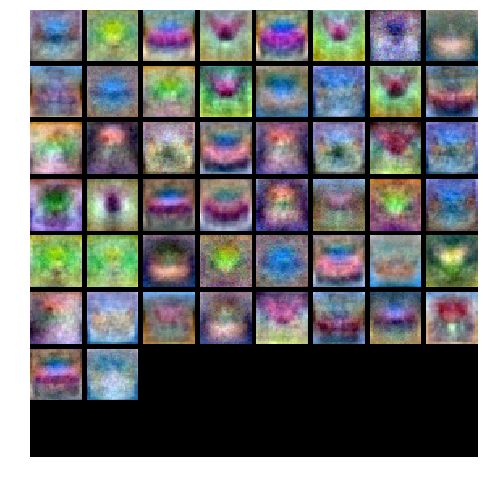

In [66]:
# visualize the weights of the best network
show_net_weights(best_net)

# Run on the test set
When you are done experimenting, you should evaluate your final trained network on the test set; you should get above 48%.

**We will give you extra bonus point for every 1% of accuracy above 52%.**

In [48]:
test_acc = (best_net.predict(X_test) == y_test).mean()
print 'Test accuracy: ', test_acc

Test accuracy:  0.526
